In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from lib.core import *
from lib.read_data_basic import *

[17:02:56] lib:INFO: Default saving mode set to do_save False
[17:02:56] lib:INFO: Making sure output folder is defined and exists in the location where the library is imported: ./test
[17:02:56] lib:INFO: Loading chromsizes for danRer11 (reduced)
[17:02:56] lib:INFO: Loading chromosome arm sizes table
[17:02:56] lib:INFO: Loading differential fountain calls (mutant vs WT)
[17:02:56] lib:INFO: Collecting cooler paths for danRer11 datasets
[17:02:56] lib:INFO: Opening base cooler at /home/agalicina/DANIO/HIC/data_danrer11/distiller/results_danrer11/coolers_library_group/WT.danrer11-reduced.mapq_30.1000.mcool::/resolutions/10000
[17:02:56] lib:INFO: Extracting bins table from cooler
[17:02:56] lib:INFO: Loading clean bins with 50 Kb buffer from unmappable regions
[17:02:56] lib:INFO: Loading CTCF motif calls from JASPAR track
[17:02:56] lib:INFO: Loading ATAC-seq peaks (ATAC-Seq_4.5h_DCD019097DT) and annotating CTCF motifs
[17:02:56] lib:INFO: Loading ATAC-seq peaks (ATAC-Seq_12h_DCD0190

In [3]:
pd.DataFrame(check_dep_versions())

,Python,tqdm,numpy,pandas,scipy,statsmodels,matplotlib,seaborn,datashader,ultraplot,scikit-learn,cooler,cooltools,bioframe,fontanka,pybbi
installed,3.12.12,4.67.1,2.3.5,2.3.3,1.16.3,0.14.5,3.10.8,0.13.2,0.18.2,1.66.0,1.7.2,0.10.4,0.7.1,0.8.0,0.2,0.4.2
expected,3.12,None,2.3.5,2.3.3,1.16.3,0.14.5,3.10.8,0.13.2,0.18.2,1.66.0,None,0.10.4,0.7.1,0.8.0,0.2,0.4.2
op,==,None,>=,>=,>=,>=,>=,>=,>=,>=,None,>=,>=,>=,>=,>=
status,installed,installed,ok,ok,ok,ok,ok,ok,ok,ok,installed,ok,ok,ok,ok,ok


In [3]:
# # Set up saving mode
do_save = True
output_folder = "./results_2025-12-03_AxG_simulations"
if not os.path.isdir(output_folder):
    os.mkdir(output_folder)

# Simulations output (Fig. 5)

In [4]:
section_start()

✅ Section started


In [122]:
import seaborn.objects as so
from cooltools.lib import numutils
import pickle
import h5py

In [6]:
def get_pile(f, window=410, aggcoef=10, positions=[250,750,1250,1750,2250]):

    hmap = np.load(f)
    
    expected_medians = []
    expected_means = []

    for i in range(len(hmap)):
        d = hmap.diagonal(i)
        expected_medians.append(np.median(d))
        expected_means.append(np.mean(d))

    hmap_ooe = np.log2(hmap/scipy.linalg.toeplitz(expected_medians))

    pile = np.zeros([window, window])
    pile_agg = np.zeros([window//aggcoef, window//aggcoef])


    for i in range(len(positions)):
        position = positions[i]
        fragment = hmap_ooe[position-window//2:position+window//2, position-window//2:position+window//2]
        pile += fragment

        pile_agg += numutils.zoom_array(fragment, (window//aggcoef, window//aggcoef))

    pile = pile/len(positions)
    pile_agg = pile_agg/len(positions)


    pile_offdiag = np.zeros([window, window])
    pile_offdiag_agg = np.zeros([window//aggcoef, window//aggcoef])

    for i in range(len(positions)):
        for j in range(i+1, len(positions)):
            position1 = positions[i]
            position2 = positions[j]
            
            fragment = hmap_ooe[position1-window//2:position1+window//2, position2-window//2:position2+window//2]

            pile_o/ffdiag += fragment

            pile_offdiag_agg += numutils.zoom_array(fragment, (window//aggcoef, window//aggcoef))

    return(pile, pile_agg, pile_offdiag, pile_offdiag_agg)

In [581]:
from skimage.draw import line_aa, line
from cooltools.lib import numutils


def fill_with_na(arr, length):
    """Fills a NumPy array with NaN values up to a specified length.

    Args:
        arr (np.ndarray): The input NumPy array.
        length (int): The desired length of the array.

    Returns:
        np.ndarray: A new NumPy array with NaN values padded to the specified length.
                      If the input array is longer than the specified length, it is truncated.
    """
    if length <= len(arr):
        return arr[:length]  # Truncate if input array is longer
    else:
        padded_arr = np.concatenate((arr, np.full(length - len(arr), np.nan)))
        return padded_arr


def return_full_protractor(mtx):

    n = mtx.shape[0]
    protractor = []

    expected_length = mtx.shape[0] // 2

    # We will retrieve protractor in two steps:
    i = 0
    for j in range(n):
        # Mask those bins that are not on the secondary diagonal:
        mask = np.zeros([n, n]).astype(np.bool_)
        rr, cc = line(n // 2, n // 2, i, j)
        mask[rr, cc] = True

        # Retrieve secondary diagonal as a list:
        positions = np.where(mask)
        vals = mtx[positions][::-1]
        vals = fill_with_na(vals, expected_length)
        protractor.append(vals)

    j = n - 1
    for i in range(1, n):
        mask = np.zeros([n, n]).astype(np.bool_)
        rr, cc = line(n // 2, n // 2, i, j)
        mask[rr, cc] = True

        positions = np.where(mask)
        vals = mtx[positions][::-1]
        vals = fill_with_na(vals, expected_length)
        protractor.append(vals)

    return np.array(protractor)

In [8]:
def load_cohesin_profile(
    LEFpositions,
    L,
    window=400,
    positions=[250, 750, 1250, 1750, 2250],
    min_time=1000,
    max_time=10000,
    verbose=True,
):
    # Generate cohesin profile:
    coh_profile = np.zeros(L)
    for locs in tqdm.tqdm(LEFpositions[min_time:max_time, :, :], disable=~verbose):
        for pos1, pos2 in locs:
            if np.isfinite(pos1) and np.isfinite(pos2):
                coh_profile[int(pos1 % L)] += 1
                coh_profile[int(pos2 % L)] += 1

    # Generate pileup of cohesin profile:
    profile_pile = np.zeros(window)
    # profile_pile_agg = np.zeros(window // aggcoef)

    for i in range(len(positions)):
        position = positions[i]
        fragment = coh_profile[position - window // 2 : position + window // 2]
        profile_pile += fragment
        # profile_pile_agg +=  numutils.zoom_array(fragment, [window//aggcoef])

    return coh_profile, profile_pile

In [9]:
import re

In [410]:
path_3d = "/net/levsha/share/agalicina/simulations/chromatin_fountains/*/maps2d/"
files = glob.glob(f"{path_3d}/*.npy")

In [413]:
# [(i, x) for i, x in enumerate(files) if 'T_20' in x and 'S_33' in x]

In [403]:
df_results = pd.DataFrame(files, columns=["file"])

In [404]:
df_results.loc[:, "prefix"] = df_results.file.apply(
    lambda x: x.split("/")[-1].replace(".npy", "")
)

df_results.loc[:, "filename_3d"] = df_results.file.apply(lambda x: x.split("/")[-1])
df_results.loc[:, "path_3d"] = df_results.file.apply(
    lambda x: "/".join(x.split("/")[:-1])
)
df_results.loc[:, "path_1d"] = df_results.path_3d.apply(
    lambda x: x.replace("maps2d", "traj1d")
)

df_results.loc[:, "mode"] = df_results.file.apply(
    lambda x: re.findall(r"([^._]*)[\.|_]", x.split("/")[-1])[0]
)
df_results.loc[:, "version"] = df_results.file.apply(
    lambda x: "old" if "sea-rises_" in x or "fountain-takeover_" in x else "new"
)

df_results.loc[:, "lifetime"] = df_results.file.apply(
    lambda x: int(re.findall(r"L_*(\d+)[\.|_]", x)[0]) if "L" in x else ""
)
df_results.loc[:, "separation"] = df_results.file.apply(
    lambda x: int(re.findall(r"(S|ST)_*(\d+)[\.|_]", x)[0][1]) if "S" in x else ""
)
df_results.loc[:, "Ntargeted"] = df_results.file.apply(
    lambda x: (
        int(re.findall(r"[.|_]T_*(\d+)[\.|_]", x)[0])
        if ("_T" in x or ".T" in x)
        else np.nan
    )
)
df_results.loc[:, "enrichment"] = df_results.file.apply(
    lambda x: (
        float(re.findall(r"[.|_]E_*((\d|\.)+)[\.|_]", x)[0][0]) if "E" in x else np.nan
    )
)
df_results.loc[:, "TADboundary"] = df_results.file.apply(
    lambda x: (
        float(re.findall(r"tads_((\d|\.)+)_", x)[0][0]) if "tads_" in x else np.nan
    )
)
df_results.loc[:, "drift"] = df_results.file.apply(
    lambda x: (
        float(re.findall(r"drift_((\d|\.)+)_", x)[0][0]) if "drift_" in x else np.nan
    )
)

df_results.loc[:, "barrier_stall"] = df_results.file.apply(
    lambda x: (
        float(re.findall(r"barriers_((\d|\.|e|-)+)_", x)[0][0])
        if "barriers_" in x
        else np.nan
    )
)


def parse_barriers_release(x):
    output = np.nan
    if "barriers_" in x:
        substr = x.split("barriers_")[1].rstrip(".npy")
        # print(substr.split('_'))
        if len(substr.split("_")) > 2 and not "MD" in x:
            output = re.findall(r"barriers_((\d|\.|e|-)+)_((\d|\.|e|-)+)_", x)[0][2]
    return float(output)


df_results.loc[:, "barrier_release"] = df_results.file.apply(parse_barriers_release)

df_results.loc[:, "lifetime_cat"] = df_results.file.apply(
    lambda x: (re.findall(r"L_*(\d+)[\.|_]", x)[0]) if "L" in x else ""
)
df_results.loc[:, "separation_cat"] = df_results.file.apply(
    lambda x: (re.findall(r"(S|ST)_*(\d+)[\.|_]", x)[0][1]) if "S" in x else ""
)
df_results.loc[:, "Ntargeted_cat"] = df_results.file.apply(
    lambda x: (
        (re.findall(r"[.|_]T_*(\d+)[\.|_|*]", x)[0])
        if ("_T" in x or ".T" in x)
        else np.nan
    )
)
df_results.loc[:, "enrichment_cat"] = df_results.file.apply(
    lambda x: (
        (re.findall(r"[.|_]E_*((\d|\.)+)[\.|_|*]", x)[0][0]) if "E" in x else np.nan
    )
)

df_results.loc[:, "MD"] = df_results.file.apply(
    lambda x: int(re.findall(r"[.|_]MD_*(\d+)", x)[0]) if "MD" in x else 200
)

In [107]:
np.unique(df_results["mode"])

array(['drifting-legs', 'drifting-legs-enrichment',
       'drifting-legs-targetonly', 'fountain-takeover',
       'growing-boundaries', 'loading-platform', 'random-barriers',
       'random-barriers-targetonly', 'realistic', 'realistic-500Kb',
       'sea-rises', 'test', 'unloading-platform'], dtype=object)

In [392]:
df_all = []

In [393]:
# `sea-rises` is the mode when the number of cohesins is set for the target, separation of background can be changed independently:
accepted_ntargeted = [8, 13, 20, 29, 33, 44, 50, 66, 100, 150]
accepted_separations = [33, 50, 100, 150, 200, 300, 900, 900, 2700]

df = df_results.query(
    'mode=="sea-rises" and lifetime==100 and MD==200 and version=="new"'
)
df = df.sort_values(["separation", "enrichment"], ascending=[True, False])
df = df.query(f"Ntargeted in {accepted_ntargeted }")
df = df.query(f"separation in {accepted_separations}")
df = df.drop_duplicates(["separation_cat", "Ntargeted_cat"])
df = df.reset_index(drop=True)

df_all.append(df.copy())

In [394]:
# `fountain-takeover` is the mode when the probability of landing to the loading platform is set relative to the whole genome:
accepted_enrichments = [
    0.0,
    1.0,
    2.0,
    5.0,
    10.0,
    15.0,
    19.0,
    20.0,
    50.0,
    75.0,
    100.0,
    150.0,
    200.0,
    250.0,
    500.0,
    750.0,
    1000.0,
]
accepted_separations = [33, 44, 50, 66, 100, 150, 200, 300, 500, 900, 2700]

# accepted_enrichments = [1.0, 2, 5, 10, 20, 50, 100]
# accepted_separations = [50, 100, 150, 200, 300, 500, 900]

df = df_results.query(
    'mode=="fountain-takeover" and lifetime==100 and MD==200 and version=="new"'
)
df = df.sort_values(["separation", "enrichment"], ascending=[True, False])
# df = df.query(f"Ntargeted in {accepted_ntargeted }")
df = df.query(f"enrichment in {accepted_enrichments}")
df = df.query(f"separation in {accepted_separations}")
df = df.drop_duplicates(["separation_cat", "enrichment_cat"])
# df = df.reset_index(drop=True)

df_all.append(df.copy())

In [395]:
# accepted_barriers = [0.005, ]
# accepted_separations = [50, 100, 150, 200, 300, 900, 900]

df = df_results.query('mode=="drifting-legs-targetonly"')
df = df.sort_values(["separation", "enrichment"], ascending=[True, False])
df = df.reset_index(drop=True)

df_all.append(df.copy())

In [396]:
df = df_results.query('mode=="random-barriers-targetonly"')
df = df.sort_values(["separation", "enrichment"], ascending=[True, False])
df = df.reset_index(drop=True)

df_all.append(df.copy())

In [397]:
df_all = pd.concat(df_all)
df_all = df_all.set_index("prefix")
df_all.head()

,file,filename_3d,path_3d,path_1d,mode,version,lifetime,separation,Ntargeted,enrichment,TADboundary,drift,barrier_stall,barrier_release,lifetime_cat,separation_cat,Ntargeted_cat,enrichment_cat,MD
prefix,,,,,,,,,,,,,,,,,,,
sea-rises.L_100.S_33.T_44.notads_0_,/net/levsha/share/agalicina/simulations/chroma...,sea-rises.L_100.S_33.T_44.notads_0_.npy,/net/levsha/share/agalicina/simulations/chroma...,/net/levsha/share/agalicina/simulations/chroma...,sea-rises,new,100,33,44.0,NaN,0.0,NaN,NaN,NaN,100,33,44,NaN,200
sea-rises.L_100.S_33.T_66.notads_0_,/net/levsha/share/agalicina/simulations/chroma...,sea-rises.L_100.S_33.T_66.notads_0_.npy,/net/levsha/share/agalicina/simulations/chroma...,/net/levsha/share/agalicina/simulations/chroma...,sea-rises,new,100,33,66.0,NaN,0.0,NaN,NaN,NaN,100,33,66,NaN,200
sea-rises.L_100.S_50.T_44.notads_0_,/net/levsha/share/agalicina/simulations/chroma...,sea-rises.L_100.S_50.T_44.notads_0_.npy,/net/levsha/share/agalicina/simulations/chroma...,/net/levsha/share/agalicina/simulations/chroma...,sea-rises,new,100,50,44.0,NaN,0.0,NaN,NaN,NaN,100,50,44,NaN,200
sea-rises.L_100.S_50.T_50.notads_0_,/net/levsha/share/agalicina/simulations/chroma...,sea-rises.L_100.S_50.T_50.notads_0_.npy,/net/levsha/share/agalicina/simulations/chroma...,/net/levsha/share/agalicina/simulations/chroma...,sea-rises,new,100,50,50.0,NaN,0.0,NaN,NaN,NaN,100,50,50,NaN,200
sea-rises.L_100.S_50.T_20.notads_0_,/net/levsha/share/agalicina/simulations/chroma...,sea-rises.L_100.S_50.T_20.notads_0_.npy,/net/levsha/share/agalicina/simulations/chroma...,/net/levsha/share/agalicina/simulations/chroma...,sea-rises,new,100,50,20.0,NaN,0.0,NaN,NaN,NaN,100,50,20,NaN,200


In [398]:
len(df_all)

492

In [345]:
do_save_intermediary = True

In [511]:
# Read 3D:
dict_3d = {}

output_path = (
    "/net/levsha/share/agalicina/simulations/chromatin_fountains/data/snippets/"
)
output_mask = "{output_path}/3d-pileup_{f}.pickle"

for i, r in tqdm.tqdm(df_all.iterrows(), total=len(df_all)):

    prefix = i  # indexed by prefix
    path_3d = r["path_3d"]
    output_file = output_mask.format(f=prefix, output_path=output_path)

    do_load = False
    if prefix in dict_3d.keys():
        continue
    elif os.path.isfile(output_file):
        try:
            with open(output_file, "rb") as f:
                list_data = pickle.load(f)
            (
                pile_3d,
                pile_3d_agg,
                offdiag_3d,
                offdiag_3d_agg,
                protractor_3d,
                crosssec_3d,
            ) = list_data
        except Exception as e:
            do_load = True
    else:
        do_load = True

    if do_load:
        file_3d = path_3d + "/" + prefix + ".npy"
        pile_3d, pile_3d_agg, offdiag_3d, offdiag_3d_agg = get_pile(file_3d)
        protractor_3d = return_full_protractor(pile_3d_agg)
        crosssec_3d = return_cross_sections(pile_3d_agg)

    # Store the output in temporary dictionary:
    dict_3d[prefix] = [
        pile_3d.copy(),
        pile_3d_agg.copy(),
        offdiag_3d.copy(),
        offdiag_3d_agg.copy(),
        protractor_3d.copy(),
        crosssec_3d.copy(),
    ]

    # Store the output in a file is requested:
    if do_save_intermediary:
        if not os.path.isfile(output_file):
            with open(output_file, "wb") as f:
                list_towrite = [
                    pile_3d.copy(),
                    pile_3d_agg.copy(),
                    offdiag_3d.copy(),
                    offdiag_3d_agg.copy(),
                    protractor_3d.copy(),
                    crosssec_3d.copy(),
                ]
                pickle.dump(list_towrite, f)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 492/492 [00:00<00:00, 714.44it/s]


In [512]:
# Read 1D:
dict_1d = {}

output_path = (
    "/net/levsha/share/agalicina/simulations/chromatin_fountains/data/snippets/"
)
output_mask = "{output_path}/1d-pileup_{f}.pickle"

for i, r in tqdm.tqdm(df_all.iterrows(), total=len(df_all)):

    prefix = i  # indexed by prefix
    path_1d = r["path_1d"]
    output_file = output_mask.format(f=prefix, output_path=output_path)

    if prefix in dict_1d.keys():
        continue
    elif os.path.isfile(output_file):
        with open(output_file, "rb") as f:
            list_data = pickle.load(f)
        coh_profile, coh_profile_pile, coh_profile_t, coh_profile_pile_t = list_data
    else:
        try:
            file_1d = path_1d + "/" + prefix + ".h5py"
            myfile = h5py.File(file_1d, mode="r")
            N = myfile.attrs["N"]
        except (OSError, KeyError) as e:
            try:
                file_1d = path_1d + "/" + prefix + ".h5py"
                myfile = h5py.File(file_1d, mode="r")
                N = myfile.attrs["N"]
            except (OSError, KeyError) as e:
                print(f"\nFailure to load for {file_1d}\n", e)
                continue

        N = myfile.attrs["N"]
        LEFNum = myfile.attrs["n_lef"]
        LEFNum_targeted = myfile.attrs["n_lef_targeted"]
        LEFpositions = myfile["positions"]
        L = myfile.attrs["system_size"]

        min_time = 1_000  # to make sure we're in equilibrated extrusion mode
        max_time = 50_000  # to load part of the whole trajectory to save some time

        # Load cohesin positions:
        coh_profile, coh_profile_pile = load_cohesin_profile(
            LEFpositions,
            L,
            window=400,
            positions=[250, 750, 1250, 1750, 2250],
            min_time=min_time,
            max_time=max_time,
        )

        # Load cohesin positions that were loaded at a target site:
        coh_profile_t, coh_profile_pile_t = load_cohesin_profile(
            LEFpositions[:, -LEFNum_targeted:, :],
            L,
            window=400,
            positions=[250, 750, 1250, 1750, 2250],
            min_time=min_time,
            max_time=max_time,
        )

    dict_1d[prefix] = [
        coh_profile.copy(),
        coh_profile_pile.copy(),
        coh_profile_t.copy(),
        coh_profile_pile_t.copy(),
    ]

    # Store the output:
    if do_save_intermediary:
        if not os.path.isfile(output_file):
            with open(output_file, "wb") as f:
                list_towrite = [
                    coh_profile.copy(),
                    coh_profile_pile.copy(),
                    coh_profile_t.copy(),
                    coh_profile_pile_t.copy(),
                ]
                pickle.dump(list_towrite, f)

 15%|█████████████████████▉                                                                                                                                | 72/492 [07:11<1:47:31, 15.36s/it]
Failure to load for /net/levsha/share/agalicina/simulations/chromatin_fountains/data_snapshot2023/traj1d/drifting-legs-targetonly.L_100.S_100.T_19.drift_0.01_.h5py
 [Errno 2] Unable to synchronously open file (unable to open file: name = '/net/levsha/share/agalicina/simulations/chromatin_fountains/data_snapshot2023/traj1d/drifting-legs-targetonly.L_100.S_100.T_19.drift_0.01_.h5py', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

Failure to load for /net/levsha/share/agalicina/simulations/chromatin_fountains/data_snapshot2023/traj1d/drifting-legs-targetonly.L_100.S_100.T_66.drift_0.001_.h5py
 [Errno 2] Unable to synchronously open file (unable to open file: name = '/net/levsha/share/agalicina/simulations/chromatin_fountains/data_snapshot2023/traj1d/drifting-legs-targ

### Load real data

In [26]:
exps = ["WT"]

stacks = {}
for exp in exps:
    stacks[exp] = fontanka.utils.read_snips(
        f"/home/agalicina/DANIO/HIC/WD_2021_paper/10_fountain_new/data/fountains/{exp}.200Kb.snips.npy"
    )

In [27]:
avfountain_ref = np.load(
    "/home/agalicina/DANIO/HIC/WD_2021_paper/10_fountain_new/data/WT.avfountain.npy"
)
df_fountain_strength = pd.DataFrame()

for exp in ["WT"]:  # all_exps:
    scores = fontanka.utils.generate_similarity_score(
        stacks[exp].T, avfountain_ref, measure="corr"
    )
    df_fountain_strength.loc[:, exp] = scores

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 134528/134528 [00:34<00:00, 3859.21it/s]


In [28]:
source_fountains = "WT"
df_fountains = pd.read_table(
    f"/home/agalicina/DANIO/HIC/WD_2021_paper/10_fountain_new/data/bed/ftop_{source_fountains}_22-03-2022.bed",
    header=None,
    index_col=3,
)
df_fountains.columns = ["chrom", "start", "end", "SIM"]

In [29]:
resolution = 10_000
flank = 200_000

In [30]:
def reflect(mtx):
    return np.nanmean([mtx, np.rot90(mtx[:, ::-1])], axis=0)


from skimage.filters import threshold_li

In [31]:
index = df_fountains.index
df = df_fountain_strength.loc[index, :]

N = len(df)

pile_reference = np.nanmean(
    stacks[source_fountains][:, :, list(df.index.values)], axis=2
)
pile_reference = reflect(pile_reference)

Text(0, 0.5, 'relative position, kbp')

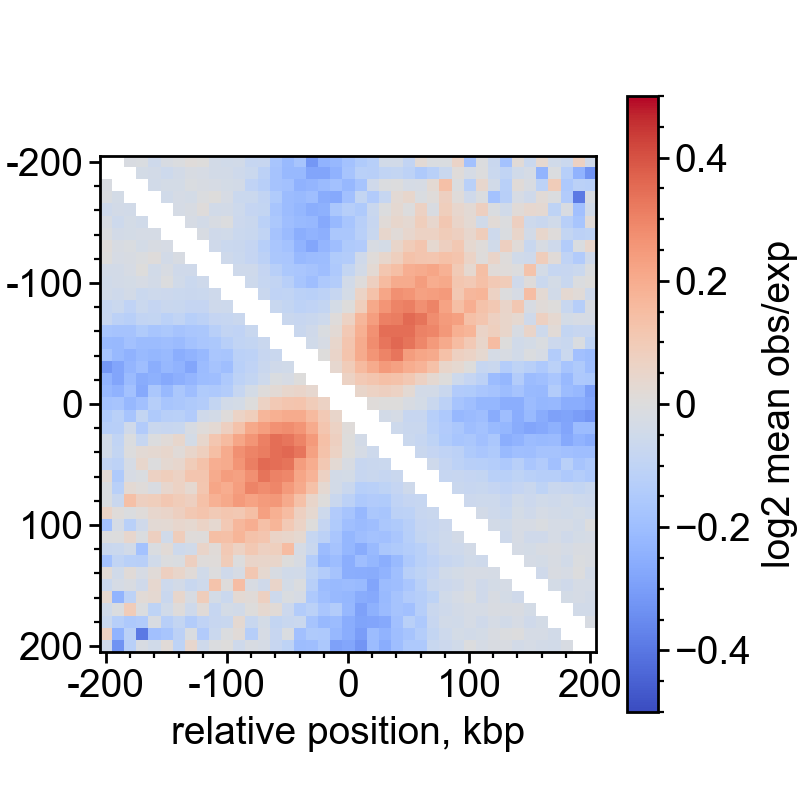

In [32]:
# Visualize, no need to save
im = plt.imshow(
    np.log2(pile_reference), vmax=0.5, vmin=-0.5, cmap="coolwarm", interpolation=None
)

plt.colorbar(label="log2 mean obs/exp")
ticks_pixels = np.linspace(0, flank * 2 // resolution, 5)
ticks_kbp = ((ticks_pixels - ticks_pixels[-1] / 2) * resolution // 1000).astype(int)
plt.xticks(ticks_pixels, ticks_kbp)
plt.yticks(ticks_pixels, ticks_kbp)
plt.xlabel("relative position, kbp")
plt.ylabel("relative position, kbp")

In [33]:
# Calculate reference protractor:
pile_reference_log = np.log2(pile_reference)
v_reference = pile_reference_log.flatten()
protractor_reference = return_full_protractor(pile_reference_log)
crosssec_reference = return_cross_sections(pile_reference_log)
v_protractor_ref = protractor_reference[40:41][0]

### Compare real fountains and simulated:

In [34]:
def mse(A, B, ax=None):
    mse_value = ((A - B) ** 2).mean(axis=ax)
    return mse_value

In [35]:
# Compare simulated data to the real one, MSE (whole map and protractor) and correlations (whole map)

cols_new = [
    "corrcoef_pearson",
    "corrcoef_spearman",
    "pvalue_pearson",
    "pvalue_spearman",
    "mse",
    "mse_protractor",
]
df_all.loc[:, cols_new] = np.nan

for prefix in tqdm.tqdm(dict_3d.keys()):

    pile_3d, pile_3d_agg, offdiag_3d, offdiag_3d_agg, protractor_3d, crosssec_3d = (
        dict_3d[prefix]
    )
    # coh_profile, coh_profile_pile, coh_profile_t, coh_profile_pile_t = dict_1d[prefix]

    v = pile_3d_agg.flatten()
    mask = np.isfinite(v) & np.isfinite(v_reference)
    corrcoef_pearson, pvalue_pearson = scipy.stats.pearsonr(v[mask], v_reference[mask])
    corrcoef_spearman, pvalue_spearman = scipy.stats.spearmanr(
        v[mask], v_reference[mask]
    )
    mse_value = mse(v[mask], v_reference[mask])

    v_protractor = protractor_3d[40:41][0]
    mask = np.isfinite(v_protractor_ref) & np.isfinite(v_protractor)
    mse_protractor_value = mse(v_protractor_ref[mask], v_protractor[mask])

    output = [
        corrcoef_pearson,
        corrcoef_spearman,
        pvalue_pearson,
        pvalue_spearman,
        mse_value,
        mse_protractor_value,
    ]
    df_all.loc[prefix, cols_new] = output

    del (
        output,
        mask,
        v_protractor,
        v,
        corrcoef_pearson,
        corrcoef_spearman,
        pvalue_pearson,
        pvalue_spearman,
        mse_value,
        mse_protractor_value,
    )

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 172/172 [00:03<00:00, 44.84it/s]


In [36]:
for col in ["corrcoef_pearson", "corrcoef_spearman", "mse", "mse_protractor"]:
    df_all.loc[:, f"{col}_fmt"] = df_all.loc[:, col].apply(lambda x: f"{x:.2f}")


df_all = df_all.sort_values(
    ["mode", "separation", "lifetime", "Ntargeted", "enrichment", "TADboundary"]
)
df_all = df_all.fillna(0)

### Plot the summary ("fountain takeover" mode; Fig5E)

In [37]:
accepted_enrichments = [1.0, 2, 5, 10, 20, 50, 100]
accepted_separations = [50, 100, 150, 200, 300, 500, 900]

In [38]:
df_toplot = df_all.query('mode=="fountain-takeover" and lifetime==100 and MD==200')
df_toplot = df_toplot.sort_values(
    ["separation", "enrichment"], ascending=[True, False]
).reset_index(drop=True)
df_toplot = df_toplot.query(f"enrichment in {accepted_enrichments}")
df_toplot = df_toplot.query(f"separation in {accepted_separations}")
df_toplot = df_toplot.drop_duplicates(["separation_cat", "enrichment_cat"])

In [39]:
len(df_toplot), len(df_toplot.drop_duplicates(["separation_cat", "enrichment_cat"]))

(49, 49)

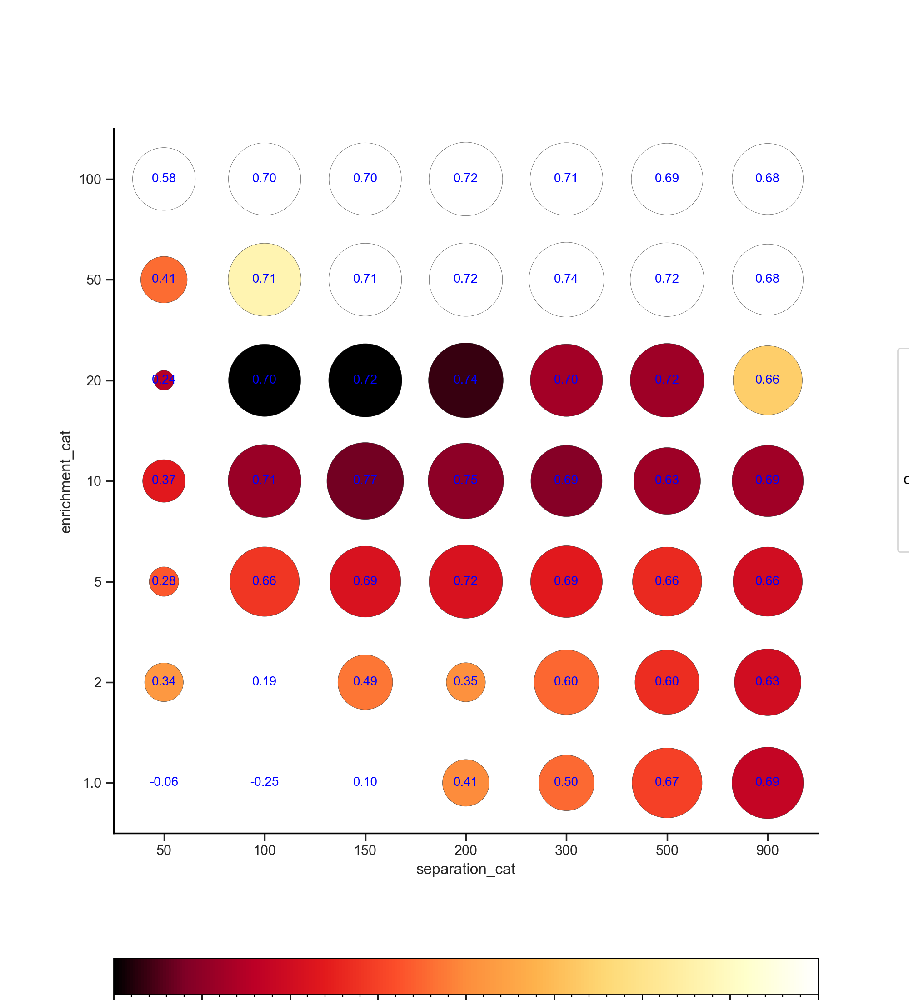

In [40]:
norm_corr = (0.2, 0.75)
norm_prot = (0.01, 0.05)

norm_mpl = mpl.colors.Normalize(*norm_prot)
cmap = "fall_r"

p = (
    so.Plot(
        df_toplot,
        x="separation_cat",
        y="enrichment_cat",
        color="mse_protractor",
        text="corrcoef_spearman_fmt",
        pointsize="corrcoef_spearman",
    )
    .add(so.Dot(edgecolor="k", edgewidth=0.2, marker="o"))
    .add(so.Text(fontsize=10, color="blue", halign="center", valign="center"))
    .scale(
        y=so.Nominal(order=[str(x) for x in accepted_enrichments][::-1]),
        x=so.Nominal(order=[str(x) for x in accepted_separations]),
        color=so.Continuous(cmap, norm=norm_prot),
        pointsize=so.Continuous((0.001, 60), norm=norm_corr).tick(
            at=[0, 0.25, 0.5, 0.75]
        ),  # , trans="power"
    )
    .theme({"axes.facecolor": "w", "axes.edgecolor": "black"})
)

f = mpl.figure.Figure(
    figsize=(10, 11),
)
sf1, sf2 = f.subfigures(2, 1, height_ratios=[1, 0.05])

res = p.on(sf1).plot()
sf1.axes[0].yaxis.tick_left()
sf1.axes[0].xaxis.tick_bottom()
sf1.axes[0].set_aspect(1)

ax_cbar = sf2.subplots(1, 1)
sf2.colorbar(
    mappable=mpl.cm.ScalarMappable(norm=norm_mpl, cmap=cmap),
    cax=sf2.axes[0],
    orientation="horizontal",
)

sns.despine(sf1)

f

In [41]:
if do_save:
    prefix = f"{output_folder}/5E.corr-spearman.fountain-takeover"
    f.savefig(f"{prefix}.pdf")

In [42]:
# Save the table:
if do_save:
    prefix = f"{output_folder}/5E.corr-spearman.fountain-takeover"

    cols = ["separation_cat", "enrichment_cat", "mse_protractor", "corrcoef_spearman"]
    df_toplot.loc[:, cols].to_csv(f"{prefix}.source.csv")

### Plot the summary ("sea rises" mode; SFig5B)

In [43]:
accepted_enrichments = [
    0.0,
    1.0,
    2.0,
    5.0,
    10.0,
    15.0,
    20.0,
    50.0,
    75.0,
    100.0,
    150.0,
    200.0,
    250.0,
    500.0,
    750.0,
    1000.0,
]
accepted_separations = [33, 50, 66, 100, 150, 200, 300, 500, 900]

In [44]:
df_toplot = df_all.query(
    'mode=="fountain-takeover" and lifetime==100 and MD==200 and version=="new"'
)
df_toplot = df_toplot.sort_values(
    ["separation", "enrichment"], ascending=[True, False]
).reset_index(drop=True)
df_toplot = df_toplot.query(f"enrichment in {accepted_enrichments}")
df_toplot = df_toplot.query(f"separation in {accepted_separations}")
df_toplot = df_toplot.drop_duplicates(["separation_cat", "enrichment_cat"])
df_toplot.loc[:, "color_font"] = df_toplot["corrcoef_spearman"].apply(
    lambda x: "white" if x > 0.5 else "black"
)

In [45]:
df_toplot[["separation", "enrichment"]] = df_toplot.loc[
    :, ["separation", "enrichment"]
].astype(np.float64)

In [46]:
len(df_toplot)

100

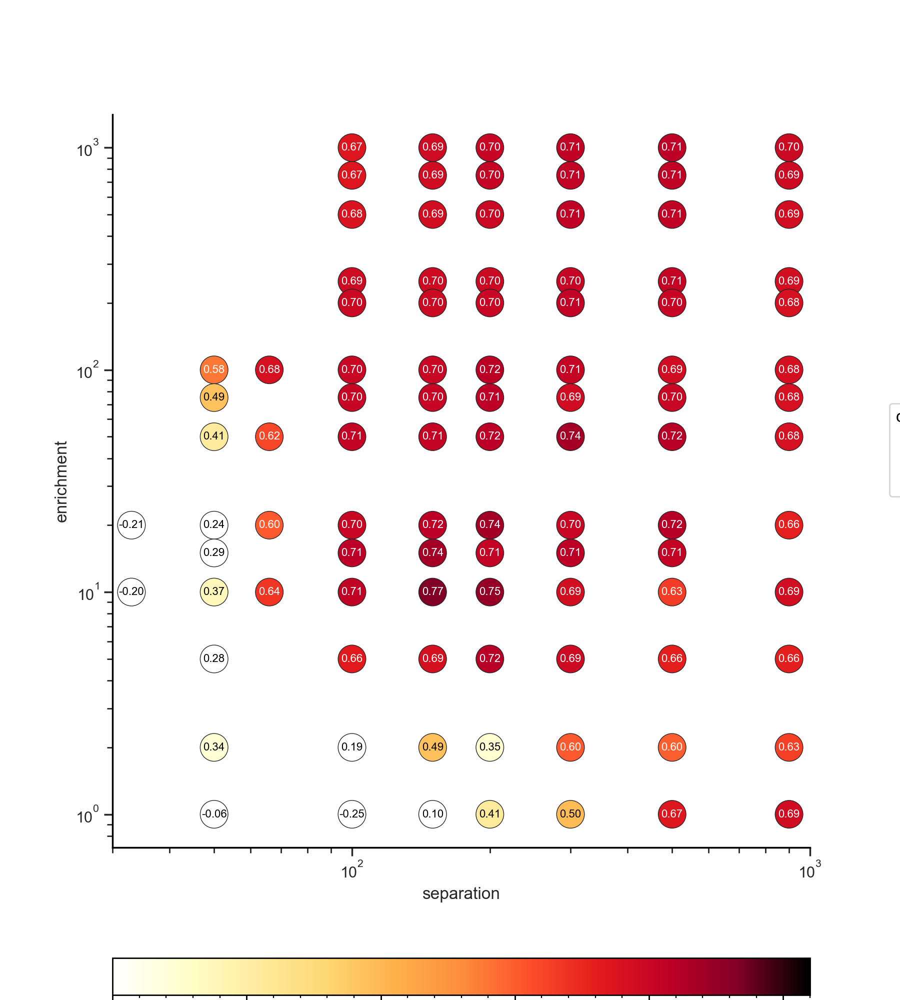

In [47]:
norm = (0.3, 0.82)
norm_mpl = mpl.colors.Normalize(*norm)
cmap = "fall"

p = so.Plot(
    df_toplot,
    x="separation",
    y="enrichment",
    color="corrcoef_spearman",
    text="corrcoef_spearman_fmt",
).add(
    so.Dot(pointsize=20, edgecolor="k", edgewidth=0.5, marker="o"),
    # legend=False
)

for c in df_toplot["color_font"].unique():
    p = p.add(
        so.Text(
            fontsize=8,
            color=c,  # fixed color for this subset
            halign="center",
            valign="center",
        ),
        legend=False,
        data=df_toplot[df_toplot["color_font"] == c],  # only those rows
    )

# Add scales etc. after building the layers
p = (
    p.scale(
        y="log",
        x="log",
        color=so.Continuous(cmap, norm=norm),  # still for corrcoef_spearman
    )
    .theme({"axes.facecolor": "w", "axes.edgecolor": "black"})
    .limit(x=(30, 1000))
)

# Format the plot, add colorbar:
f = mpl.figure.Figure(
    figsize=(9, 10),
)
sf1, sf2 = f.subfigures(2, 1, height_ratios=[1, 0.05])

res = p.on(sf1).plot()
sf1.axes[0].yaxis.tick_left()
sf1.axes[0].xaxis.tick_bottom()

ax_cbar = sf2.subplots(1, 1)
sf2.colorbar(
    mappable=mpl.cm.ScalarMappable(norm=norm_mpl, cmap=cmap),
    cax=sf2.axes[0],
    orientation="horizontal",
)

sns.despine(sf1)

f

In [48]:
if do_save:
    prefix = f"{output_folder}/SFig5E.corr-spearman.fountain-takeover"
    f.savefig(f"{prefix}.pdf")

In [49]:
# Save the table:
if do_save:
    prefix = f"{output_folder}/SFig5B.corr-spearman.fountain-takeover"

    cols = ["separation_cat", "enrichment_cat", "corrcoef_spearman", "mse_protractor"]
    df_toplot.loc[:, cols].to_csv(f"{prefix}.source.csv")

### Comparison of protractor (Fig. 5D)

In [50]:
accepted_enrichments = [1.0, 2, 5, 10, 20, 50, 100]
accepted_separations = [50, 100, 150, 200, 300, 500, 900]

In [54]:
df_toplot = df_all.query('mode=="fountain-takeover" and lifetime==100 and MD==200')
df_toplot = df_toplot.sort_values(["separation", "enrichment"], ascending=[True, False])
df_toplot = df_toplot.query(f"enrichment in {accepted_enrichments}")
df_toplot = df_toplot.query(f"separation in {accepted_separations}")
df_toplot = df_toplot.drop_duplicates(["separation_cat", "enrichment_cat"], keep="last")

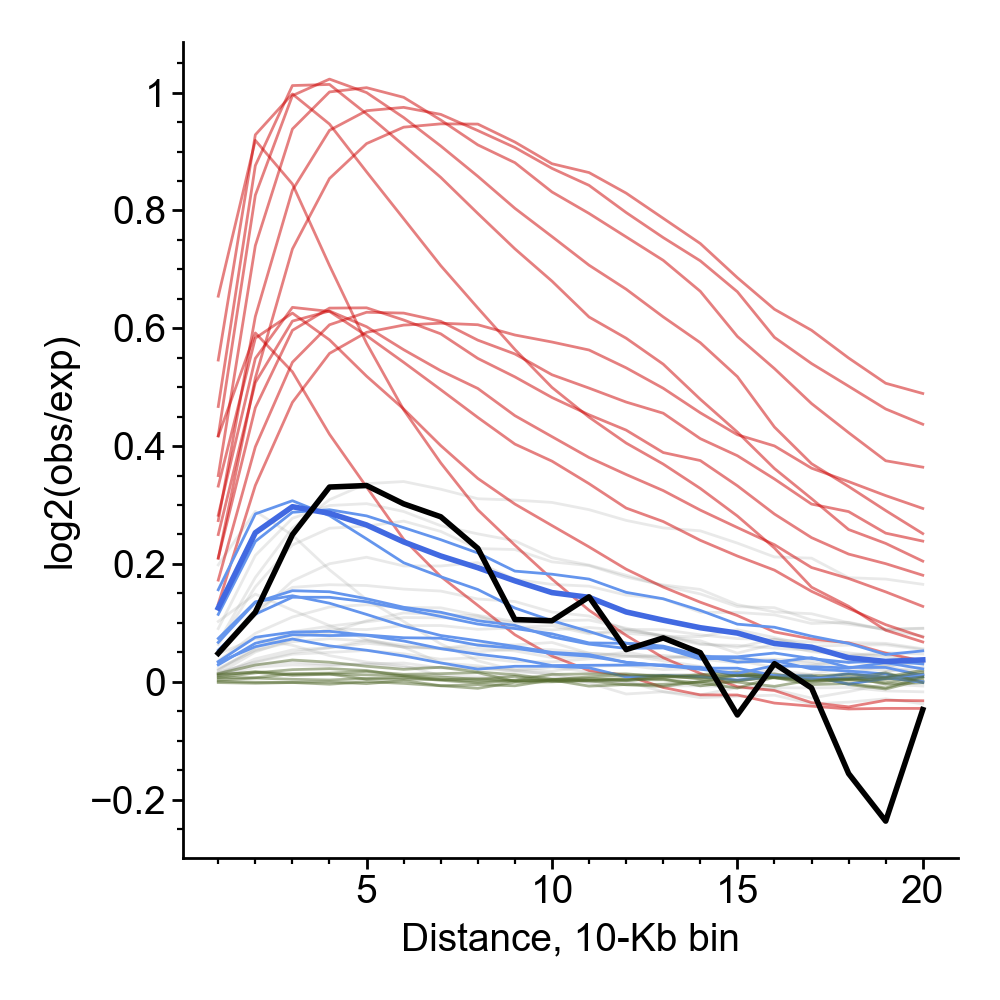

In [71]:
resolution = 10000  # 10 kb

# -------------------------------------------------------------------
# Configuration of selection categories and their plotting styles
# -------------------------------------------------------------------
CATEGORIES = [
    dict(
        name="best",
        enrichments={20},
        separations={150},
        style=dict(color="royalblue", alpha=1.0, lw=2.0, zorder=20),
    ),
    dict(
        name="good",
        enrichments={5, 10, 20},
        separations={100, 150, 200},
        style=dict(color="cornflowerblue", lw=1.0),
    ),
    dict(
        name="weakcorr",
        enrichments={1.0, 2},
        separations={50, 100, 150, 200},
        style=dict(color="darkolivegreen", alpha=0.5, lw=1.0),
    ),
    dict(
        name="weakmse",
        enrichments={50, 100},
        separations={50, 100, 150, 200, 300, 500, 900},
        style=dict(color="#cc0100", alpha=0.5, lw=1.0, zorder=-1),
    ),
]

DEFAULT_STYLE = dict(color="gray", alpha=0.2, lw=1.0, zorder=-2)


def get_style(enrichment, separation):
    """Return plotting style dict based on enrichment and separation."""
    for cat in CATEGORIES:
        if enrichment in cat["enrichments"] and separation in cat["separations"]:
            return cat["style"]
    return DEFAULT_STYLE


# -------------------------------------------------------------------
# Plotting + collect protractors into a dataframe
# -------------------------------------------------------------------
fig, ax = plt.subplots(1, 1, figsize=(5, 5))

rows = []  # will hold data for the dataframe

for prefix, row in df_toplot.iterrows():
    prefix = prefix
    enrichment = row["enrichment"]
    separation = row["separation"]

    # unpack only what we need: protractor_3d
    _, _, _, _, protractor_3d, _ = dict_3d[prefix]

    # profile to plot (same as protractor_3d[40:41][0], but clearer)
    profile = protractor_3d[40:41][0]

    style = get_style(enrichment, separation)
    ax.plot(profile, **style)

    # --- collect data for this protractor ---
    n_bins = len(profile)
    positions_bp = np.arange(n_bins) * resolution  # re-index in bp

    for pos_bp, value in zip(positions_bp, profile):
        rows.append(
            {
                "prefix": prefix,
                "enrichment": enrichment,
                "separation": separation,
                "position_bp": pos_bp,
                "protractor_value": value,
            }
        )

# Reference profile plotted on top
ref_profile = protractor_reference[40:41][0]
ax.plot(ref_profile, color="black", lw=2.0, zorder=20)

# Also store reference profile in the table (optional but handy)
n_bins_ref = len(ref_profile)
positions_bp_ref = np.arange(n_bins_ref) * resolution
for pos_bp, value in zip(positions_bp_ref, ref_profile):
    rows.append(
        {
            "prefix": "reference",
            "enrichment": 0,
            "separation": 0,
            "position_bp": pos_bp,
            "protractor_value": value,
        }
    )

ax.set_xlabel("Distance, 10-Kb bin")
ax.set_ylabel("log2(obs/exp)")

sns.despine(fig)
fig.tight_layout()

if do_save:
    prefix = f"{output_path}/Fig5E.protractors-comparison"
    fig.savefig(f"{prefix}.pdf")

In [73]:
# Build DataFrame and save as CSV:
protractor_df = pd.DataFrame(rows)
protractor_df = protractor_df.sort_values(
    ["prefix", "enrichment", "separation", "position_bp"]
)

protractor_output = protractor_df.pivot_table(
    index="position_bp",
    columns=["prefix", "enrichment", "separation"],
    values="protractor_value",
)

In [75]:
if do_save:
    csv_path = f"{output_folder}/Fig5E.protractors-comparison.profiles.csv"
    protractor_output.to_csv(csv_path, index=False)
    print(f"Saved protractor profiles to: {csv_path}")

Saved protractor profiles to: ./results_2025-12-03_AxG_simulations/Fig5E.protractors-comparison.profiles.csv


### Plot the pileups and cohesin profiles

In [144]:
def plot_heatmap(
    pile,
    vmin=-0.5,
    vmax_scale1=0.5,
    vmax_scale2=2.5,
    flank=200000,
    resolution=10000,
    interpolation="none",
    withlabels=True,
    ax_hmap=None,
    grid_bar=None,
    fig=None,
):
    """
    Plot a heatmap with two color ranges and stacked colorbars on the right.

    If ax_hmap, grid_bar and fig are all None, a new figure is created with:
      - a main heatmap axis
      - two colorbar axes stacked on the right (top: high range, bottom: low range)

    If ax_hmap and grid_bar are provided, the heatmap is drawn into ax_hmap and
    the colorbar axes are created inside the SubplotSpec given by grid_bar.
    """
    created_fig = False

    # Figure / axes creation
    if ax_hmap is None and grid_bar is None and fig is None:
        # Standalone figure: heatmap + 2 colorbars on the right
        created_fig = True
        fig = plt.figure(figsize=(6, 6), layout="constrained")

        # 2x2 grid: heatmap spans both rows in col 0,
        # colorbars sit in col 1 (top & bottom)
        gs = fig.add_gridspec(
            nrows=2,
            ncols=2,
            width_ratios=[1, 0.1],
            height_ratios=[2, 1],
            wspace=0.1,
            hspace=0.0,
        )

        ax = fig.add_subplot(gs[:, 0])
        ax_cbar_high = fig.add_subplot(gs[0, 1])
        ax_cbar_low = fig.add_subplot(gs[1, 1])

    else:
        # Using existing axes / layout
        if fig is None:
            # If ax_hmap is provided but fig isn't, infer fig from ax_hmap
            fig = ax_hmap.figure

        ax = ax_hmap

        if grid_bar is not None:
            # Create two stacked colorbar axes inside the provided SubplotSpec
            inner_gs = grid_bar.subgridspec(
                nrows=2,
                ncols=1,
                height_ratios=[2, 1],
                hspace=0.0,
            )
            ax_cbar_high, ax_cbar_low = inner_gs.subplots()
        else:
            # Fallback: simple inset colorbars to the right of the heatmap
            from mpl_toolkits.axes_grid1 import make_axes_locatable

            divider = make_axes_locatable(ax)
            ax_cbar_high = divider.append_axes("right", size="5%", pad=0.05)
            ax_cbar_low = divider.append_axes("right", size="5%", pad=0.30)

    # Split pile into two layers by threshold vmax_scale1
    pile_1 = pile.copy()
    pile_1[pile_1 >= vmax_scale1] = np.nan  # low-scale part

    pile_2 = pile.copy()
    pile_2[pile_2 < vmax_scale1] = np.nan  # high-scale part

    # Colormaps / norms
    norm_1 = mpl.colors.Normalize(vmin, vmax_scale1)
    cmap_1 = "coolwarm"

    norm_2 = mpl.colors.Normalize(vmax_scale1, vmax_scale2)
    cmap_2 = mpl.colors.LinearSegmentedColormap.from_list(
        "", [plt.cm.get_cmap("coolwarm", 1)(1), "black"]
    )

    # Main heatmap
    im1 = ax.imshow(
        pile_1,
        cmap=cmap_1,
        norm=norm_1,
        interpolation=interpolation,
    )
    im2 = ax.imshow(
        pile_2,
        cmap=cmap_2,
        norm=norm_2,
        interpolation=interpolation,
    )

    # Colorbars
    cbar_low = fig.colorbar(im1, cax=ax_cbar_low)
    cbar_high = fig.colorbar(im2, cax=ax_cbar_high)

    # Put ticks on the left side of both colorbars
    cbar_low.ax.yaxis.set_ticks_position("left")
    cbar_high.ax.yaxis.set_ticks_position("left")

    # Remove spines on colorbars for a cleaner look
    for cbar in (cbar_low, cbar_high):
        for spine in cbar.ax.spines.values():
            spine.set_visible(False)

    # Axes ticks / labels in genomic units
    ticks_pixels = np.linspace(0, flank * 2 // resolution, 5)
    ticks_kbp = ((ticks_pixels - ticks_pixels[-1] / 2) * resolution // 1000).astype(int)

    ax.set_xticks(ticks_pixels)
    ax.set_yticks(ticks_pixels)

    if withlabels:
        ax.set_xlabel("relative position, kbp")
        ax.set_ylabel("relative position, kbp")
        ax.set_xticklabels(ticks_kbp)
        ax.set_yticklabels(ticks_kbp)
    else:
        ax.set_xticklabels([])
        ax.set_yticklabels([])

    # If we created the figure here, we can adjust layout once
    if created_fig and fig.get_layout_engine() is None:
        fig.tight_layout()

    return fig


def set_genomic_ticks(ax, on_axes, flank, resolution, aggcoef=1, withlabels=True):
    """
    Set x/y tick positions and labels in genomic (kbp) units.
    """
    ticks_pixels = aggcoef * np.linspace(0, flank * 2 // resolution, 5)
    ticks_kbp = ((ticks_pixels - ticks_pixels[-1] / 2) * resolution // 1000).astype(
        int
    ) // aggcoef

    if "y" in on_axes:
        ax.set_yticks(ticks_pixels)
        ax.set_yticklabels(ticks_kbp)
        if withlabels:
            ax.set_ylabel("relative position, Kbp")

    if "x" in on_axes:
        ax.set_xticks(ticks_pixels)
        ax.set_xticklabels(ticks_kbp)
        if withlabels:
            ax.set_xlabel("relative position, Kbp")

    return ax

In [533]:
def plot_cros_sections(
    sections, agg_coef=10, ax=None, each="all", cmap="twilight", color=None
):

    if each == "all":
        each = 1

    cmap = sns.color_palette(cmap, 1 + (len(sections) // each))

    if ax is None:
        f, ax = plt.subplots(1, 1, figsize=[7, 5])

    for i, section in enumerate(sections):
        if i % each != 0:
            continue
        ax.plot(
            agg_coef * (np.arange(len(section)) + i // 2),
            section,
            alpha=0.5,
            color=cmap[i // each] if color is None else color,
        )

    return ax


def plot_protractor(
    sections,
    agg_coef=10,
    ax=None,
    orient="vertical",
    start=200,
    cmap="twilight",
    color=None,
):

    cmap = sns.color_palette(cmap, len(sections))

    if ax is None:
        f, ax = plt.subplots(1, 1, figsize=[7, 5])

    for i, section in enumerate(sections):
        if orient == "horizontal" or orient.startswith("h"):
            ax.plot(
                start + agg_coef * (np.arange(len(section)) + i // 2),
                section,
                alpha=0.5,
                color=cmap[i] if color is None else color,
            )
            ax.plot(
                start - agg_coef * (np.arange(len(section)) + i // 2),
                section,
                alpha=0.5,
                color=cmap[i] if color is None else color,
            )
        else:
            ax.plot(
                section,
                start + agg_coef * (np.arange(len(section)) + i // 2),
                alpha=0.5,
                color=cmap[i] if color is None else color,
            )
            ax.plot(
                section,
                start - agg_coef * (np.arange(len(section)) + i // 2),
                alpha=0.5,
                color=cmap[i] if color is None else color,
            )
    return ax


def plot_sim_summary(
    pile_3d,
    crosssec_3d,
    protractor_3d,
    coh_profile_pile,
    coh_profile_pile_t,
    resolution=1000,
    agg_coef=10,
    vmax_scale1=0.25,
    vmin=-0.25,
    vmax_scale2=1.0,
):

    # Create figure + top-level GridSpec in a modern way
    fig = plt.figure(figsize=(6, 7), layout="constrained")
    gs = fig.add_gridspec(
        nrows=3,
        ncols=3,
        height_ratios=[0.2, 1, 0.2],
        width_ratios=[0.05, 1, 0.2],
    )

    # Axes layout (only create the ones you actually use)
    ax_crosssec = fig.add_subplot(gs[0, 1])
    ax_heatmap = fig.add_subplot(gs[1, 1], sharex=ax_crosssec)
    ax_protractor = fig.add_subplot(gs[1, 2], sharey=ax_heatmap)
    ax_coverage = fig.add_subplot(gs[2, 1], sharex=ax_crosssec)

    # SubplotSpec where the heatmap colorbars will live (middle row, left column)
    grid_bar = gs[1, 0]

    # Heatmap with two color scales + stacked colorbars
    plot_heatmap(
        pile_3d,
        resolution=resolution,
        vmax_scale1=vmax_scale1,
        vmin=vmin,
        vmax_scale2=vmax_scale2,
        withlabels=False,
        ax_hmap=ax_heatmap,
        grid_bar=grid_bar,
        fig=fig,
    )

    set_genomic_ticks(
        ax_heatmap,
        on_axes="y",
        flank=200000,
        resolution=10000,
        aggcoef=10,
        withlabels=False,
    )

    # Cross-sections
    plot_cros_sections(crosssec_3d, ax=ax_crosssec, each=5)
    set_genomic_ticks(
        ax_crosssec,
        on_axes="x",
        flank=200000,
        resolution=10000,
        aggcoef=10,
        withlabels=False,
    )

    # Coverage profiles
    x_cov = agg_coef * (np.arange(len(coh_profile_pile)) + 0.5)
    ax_coverage.plot(
        x_cov,
        coh_profile_pile / np.nansum(coh_profile_pile),
        color="#CA2C29",
    )

    x_cov_t = agg_coef * (np.arange(len(coh_profile_pile_t)) + 0.5)
    ax_coverage.plot(
        x_cov_t,
        coh_profile_pile_t / np.nansum(coh_profile_pile_t),
        color="#2F7DE0",
    )

    set_genomic_ticks(
        ax_coverage,
        on_axes="x",
        flank=200000,
        resolution=10000,
        aggcoef=10,
        withlabels=False,
    )

    # Protractor
    plot_protractor(
        protractor_3d[40:41],
        ax=ax_protractor,
        agg_coef=10,
        orient="vertical",
        color="k",
    )

    # Cosmetic tweaks
    sns.despine(ax=ax_crosssec)
    sns.despine(ax=ax_coverage)
    sns.despine(ax=ax_protractor)

    ax_protractor.set_yticklabels([])
    ax_crosssec.set_xticklabels([])

    spinewidth = 2
    for ax in (ax_heatmap, ax_crosssec, ax_coverage, ax_protractor):
        for spine in ax.spines.values():
            spine.set_linewidth(spinewidth)
        ax.minorticks_off()

    return fig

In [516]:
if do_save:
    if not os.path.isdir(f"{output_folder}/Fig5-SFig5_profiles"):
        os.mkdir(f"{output_folder}/Fig5-SFig5_profiles")

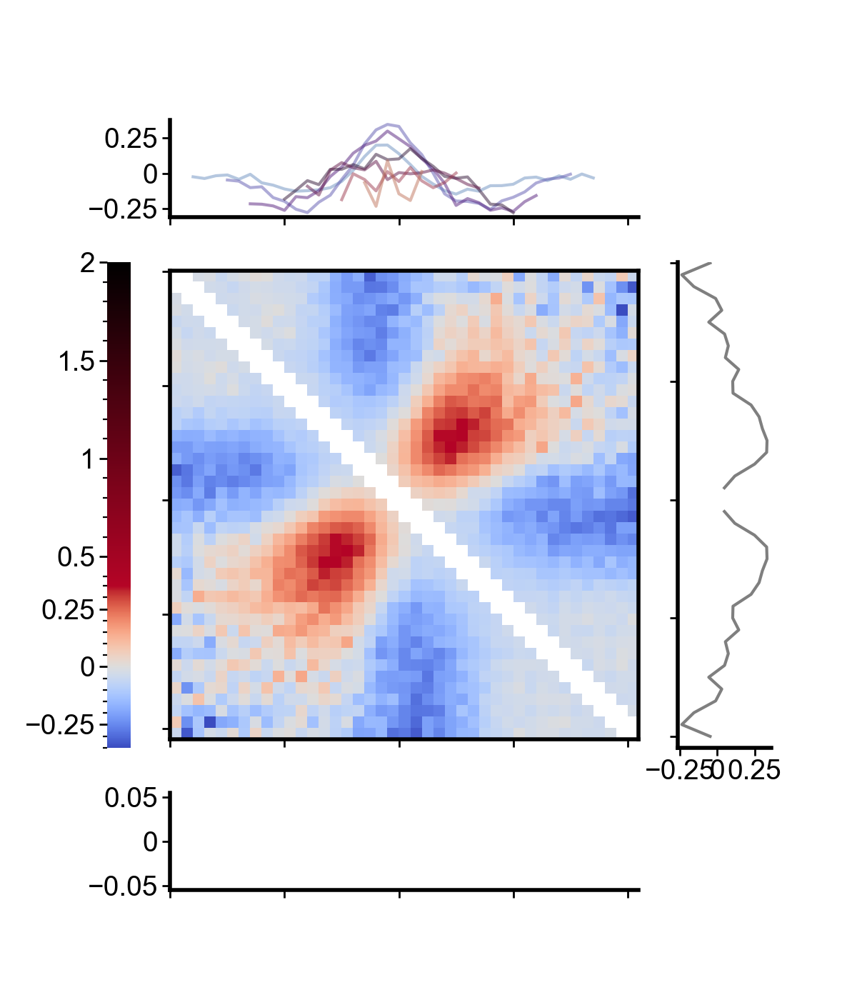

In [538]:
# Plot true Hi-C aggregated pileup
# Perform technical expansion of the matrix to make the  dimensions fit those of simulations output:
pile_reference_expanded = np.repeat(np.repeat(pile_reference, 10, axis=0), 10, axis=1)
fig = plot_sim_summary(
    np.log2(pile_reference_expanded),
    crosssec_reference,
    protractor_reference,
    [],
    [],
    resolution=10000,
    vmin=-0.35,
    vmax_scale1=0.35,
    vmax_scale2=2.0,
)

if do_save:
    fig.savefig(f"{output_folder}/Fig5-SFig5_profiles/profile_reference.pdf")

In [539]:
np.unique(df_all["mode"])

array(['drifting-legs-targetonly', 'fountain-takeover',
       'random-barriers-targetonly', 'sea-rises'], dtype=object)

In [553]:
# plot profiles for the main figure Fig. 5b and c:
toplot = [
    (
        0,
        "top left",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==900 and enrichment==20'
        ),
        (-0.35, 0.35, 2.0),
    ),
    (
        1,
        "mid left",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==150 and enrichment==20'
        ),
        (-0.35, 0.35, 2.0),
    ),
    (
        2,
        "bottom left",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==50 and enrichment==20'
        ),
        (-0.35, 0.35, 2.0),
    ),
    (
        3,
        "top mid",
        df_all.query(
            'mode=="random-barriers-targetonly" and lifetime==100 and separation==1000 and Ntargeted==19 and barrier_stall==0.0005'
        ),
        (-1.2, 1.2, 6.0),
    ),
    (
        4,
        "mid mid",
        df_all.query(
            'mode=="random-barriers-targetonly" and lifetime==100 and separation==5000 and Ntargeted==19 and barrier_stall==0.1 and barrier_release==0.05'
        ),
        (-1.2, 1.2, 6.0),
    ),
    (
        5,
        "bottom mid",
        df_all.query(
            'mode=="random-barriers-targetonly" and lifetime==100 and separation==5000 and Ntargeted==19 and barrier_stall==0.1 and barrier_release==0.01'
        ),
        (-1.2, 1.2, 6.0),
    ),
    (
        6,
        "top right",
        df_all.query(
            'mode=="drifting-legs-targetonly" and lifetime==100 and separation==5000 and Ntargeted==20 and drift==0.99'
        ),
        (-1.2, 1.2, 6.0),
    ),
    (
        7,
        "mid right",
        df_all.query(
            'mode=="drifting-legs-targetonly" and lifetime==100 and separation==5000 and Ntargeted==20 and drift==0.5'
        ),
        (-1.2, 1.2, 6.0),
    ),
    (
        8,
        "bottom right",
        df_all.query(
            'mode=="drifting-legs-targetonly" and lifetime==100 and separation==5000 and Ntargeted==20 and drift==0.01'
        ),
        (-1.2, 1.2, 6.0),
    ),
]

0 fountain-takeover.L_100.ST_900.E_20.notads_0_
1 fountain-takeover.L_100.ST_150.E_20.notads_0_
2 fountain-takeover.L_100.ST_50.E_20.notads_0_
3 random-barriers-targetonly.L_100.S_1000.T_19.barriers_0.0005_
4 random-barriers-targetonly.L_100.S_5000.T_19.barriers_0.1_0.05_
5 random-barriers-targetonly.L_100.S_5000.T_19.barriers_0.1_0.01_
6 drifting-legs-targetonly.L_100.S_5000.T_20.drift_0.99_
7 drifting-legs-targetonly.L_100.S_5000.T_20.drift_0.5_
8 drifting-legs-targetonly.L_100.S_5000.T_20.drift_0.01_


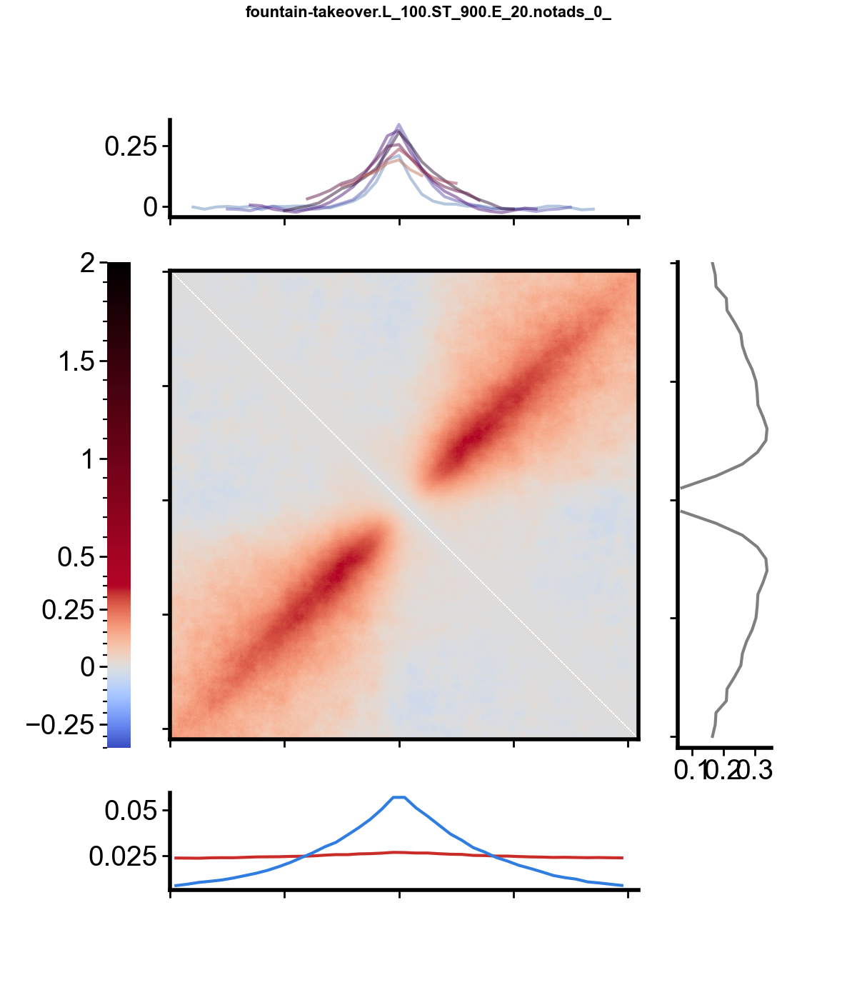

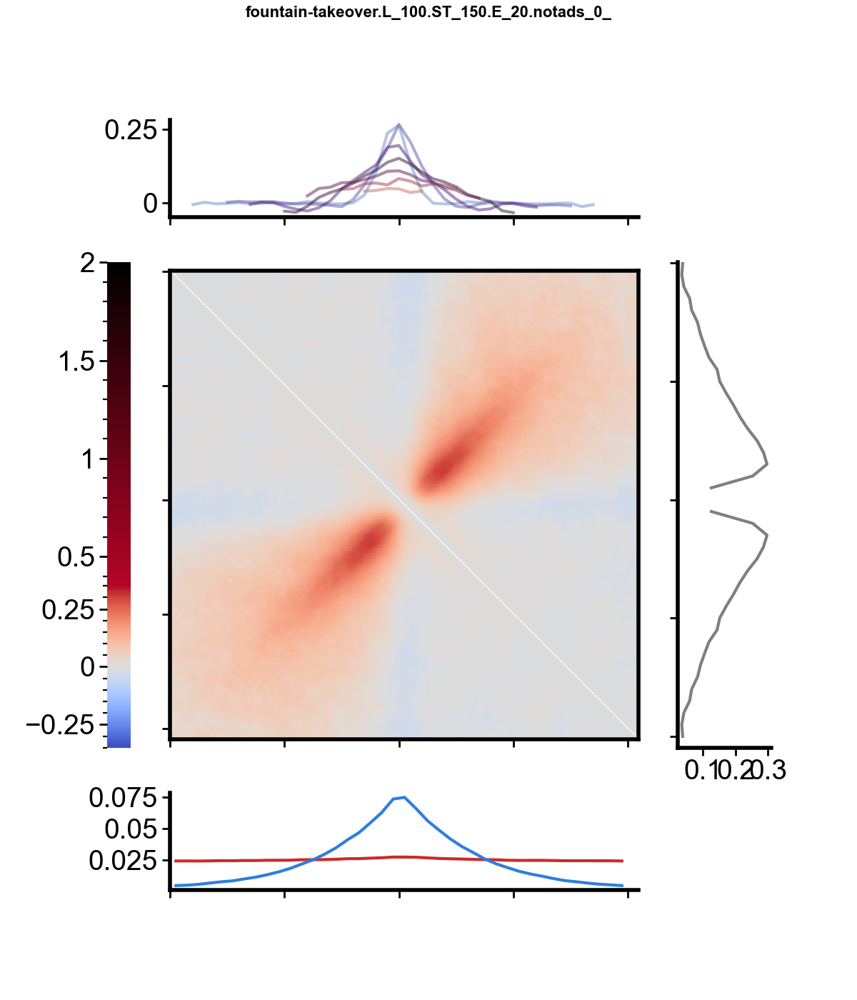

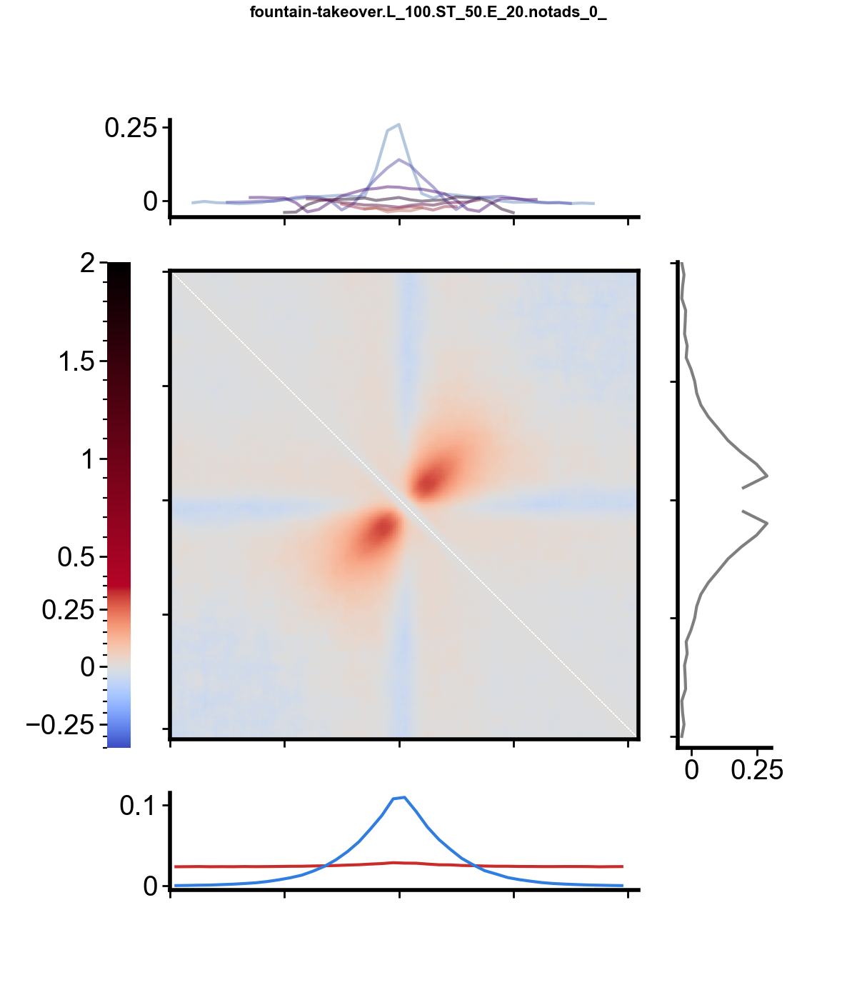

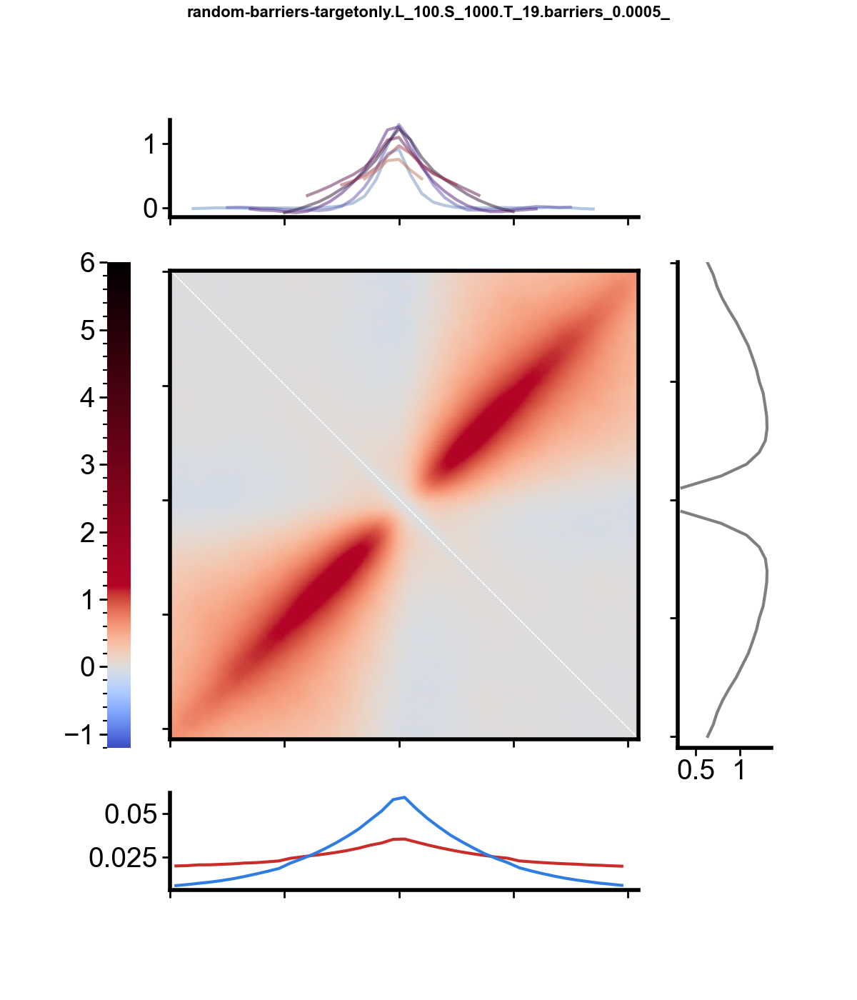

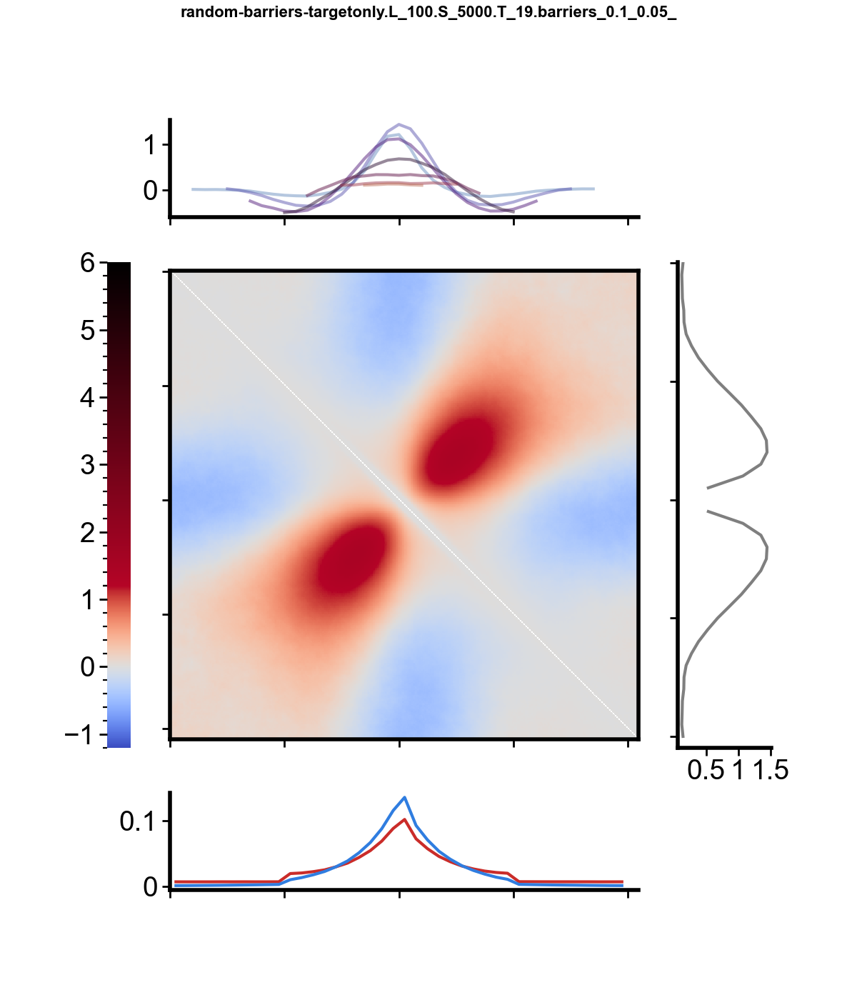

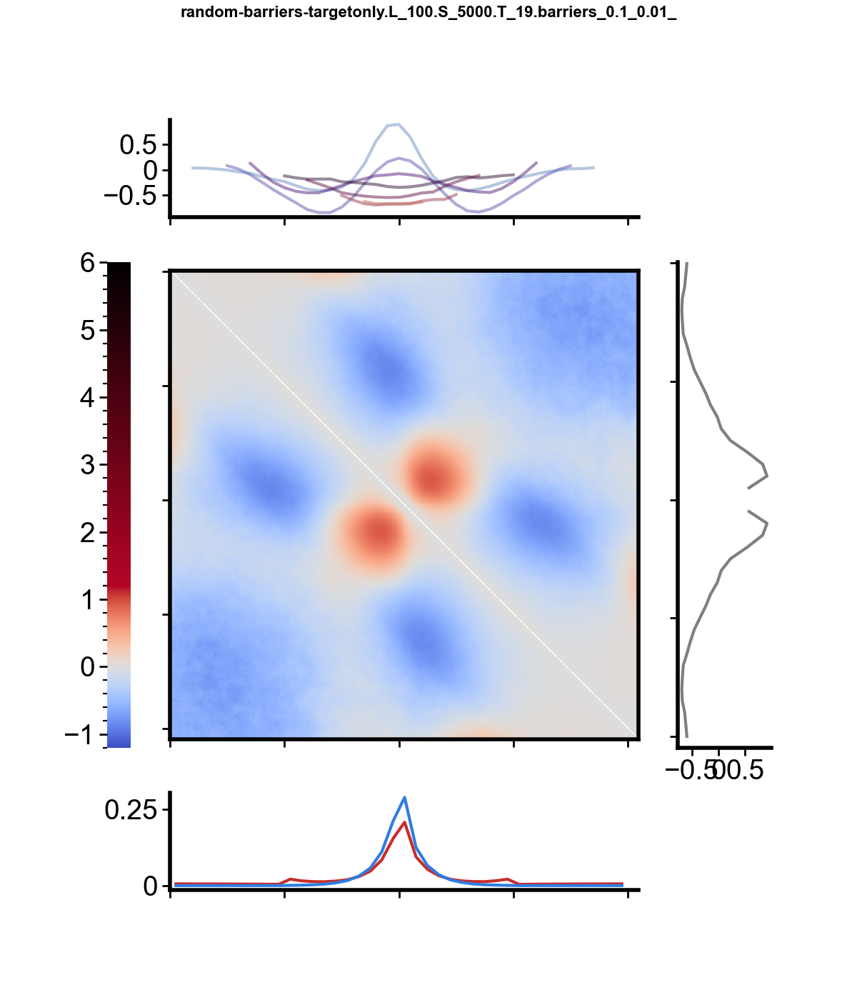

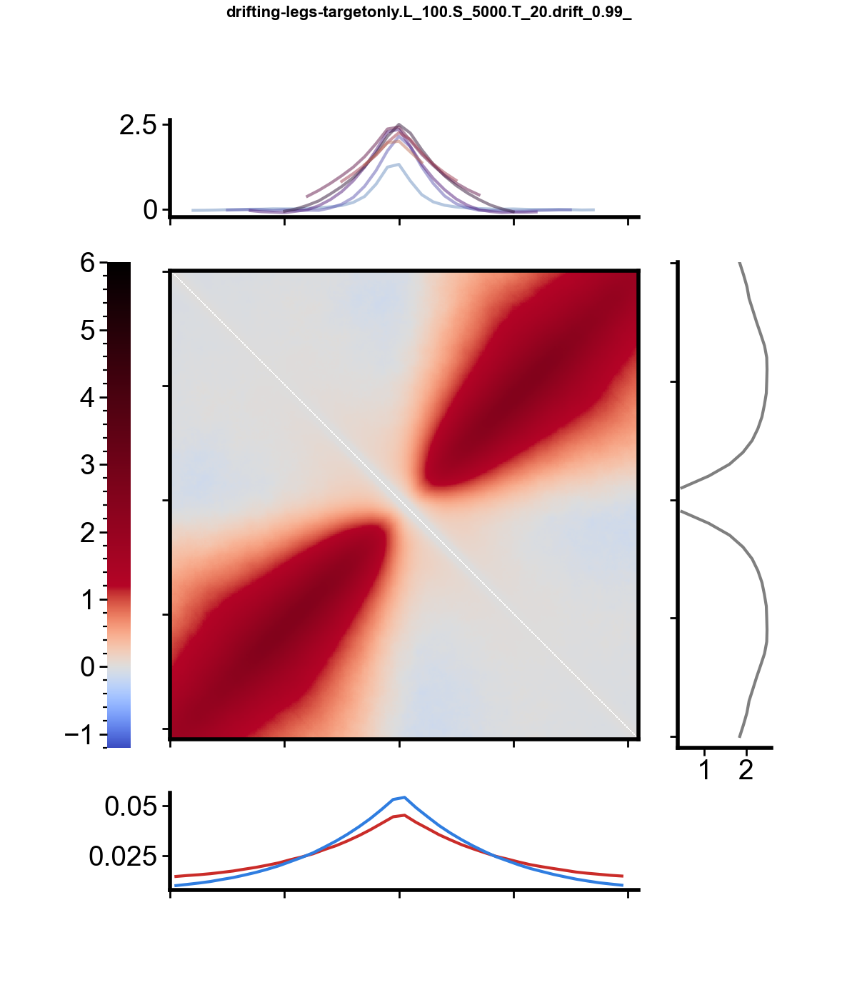

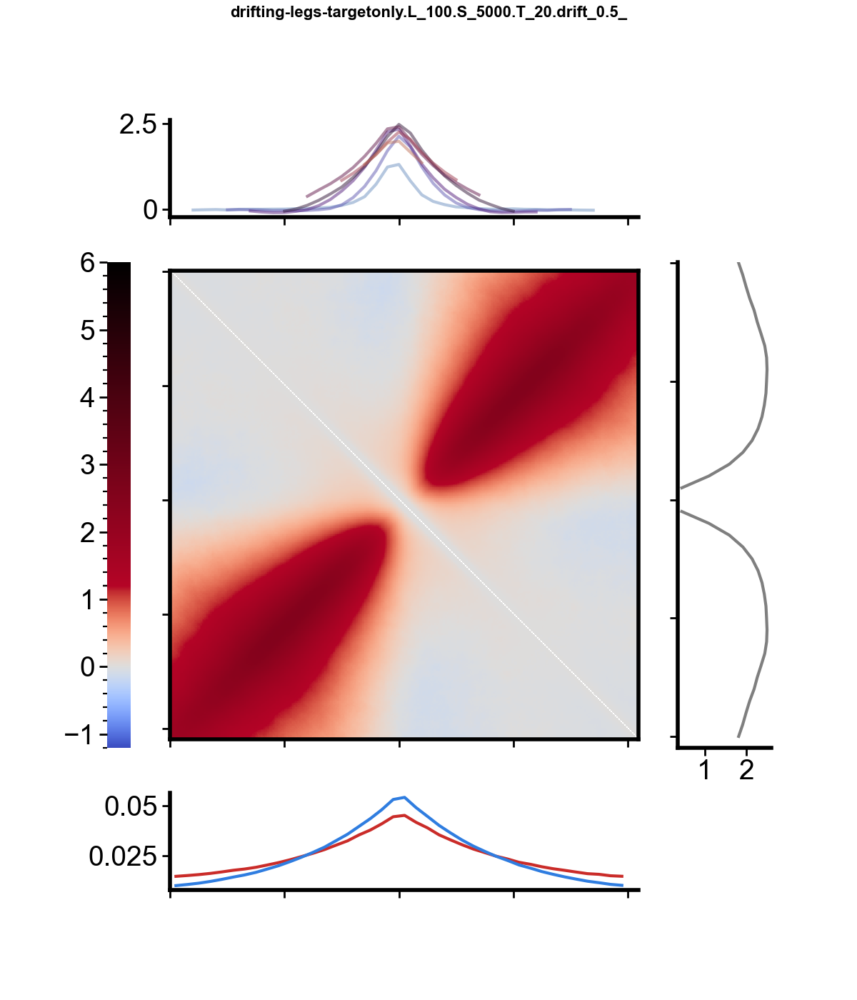

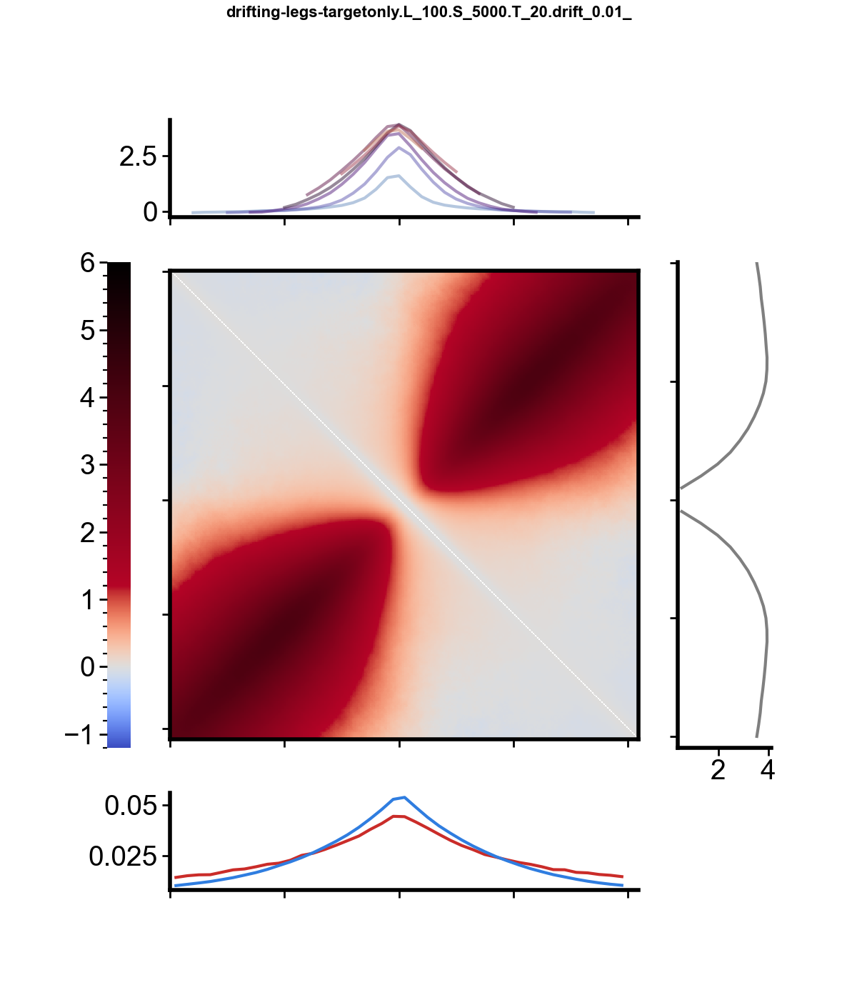

In [554]:
for i, position, df, colorscale in toplot:
    for prefix, r in df.iterrows():

        print(i, prefix)
        enrichment = r["enrichment"]
        separation = r["separation"]
        vmin, vmax1, vmax2 = colorscale

        try:
            (
                pile_3d,
                pile_3d_agg,
                offdiag_3d,
                offdiag_3d_agg,
                protractor_3d,
                crosssec_3d,
            ) = dict_3d[prefix]
            coh_profile, coh_profile_pile, coh_profile_t, coh_profile_pile_t = dict_1d[
                prefix
            ]

            coh_profile_upd = np.sum(coh_profile_pile.reshape(-1, 10), axis=1)
            coh_profile_upd_t = np.sum(coh_profile_pile_t.reshape(-1, 10), axis=1)

            fig = plot_sim_summary(
                pile_3d,
                crosssec_3d,
                protractor_3d,
                coh_profile_upd,
                coh_profile_upd_t,
                resolution=10000,
                vmin=vmin,
                vmax_scale1=vmax1,
                vmax_scale2=vmax2,
            )
            fig.suptitle(prefix, fontsize=8)

            if do_save:
                output_file = f"{output_folder}/Fig5-SFig5_profiles/Fig5B_{i}_profile_{prefix}.pdf"
                fig.savefig(output_file)

            # plt.close('all')
        except Exception as e:
            print(prefix, e)

        break

In [555]:
# plot profiles for Suppl. Figures 5a
toplot = [
    (
        0,
        "top 1",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==100 and enrichment==2'
        ),
        (-0.25, 0.25, 2.5),
    ),
    (
        1,
        "top 2",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==100 and enrichment==20'
        ),
        (-0.25, 0.25, 2.5),
    ),
    (
        2,
        "top 3",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==100 and enrichment==75'
        ),
        (-0.25, 0.25, 2.5),
    ),
    (
        3,
        "bottom 1",
        df_all.query(
            'mode=="sea-rises" and lifetime==100 and separation==2700 and Ntargeted==20'
        ),
        (-0.25, 0.25, 2.5),
    ),
    (
        4,
        "bottom 2",
        df_all.query(
            'mode=="sea-rises" and lifetime==100 and separation==900 and Ntargeted==20'
        ),
        (-0.25, 0.25, 2.5),
    ),
    (
        5,
        "bottom 3",
        df_all.query(
            'mode=="sea-rises" and lifetime==100 and separation==300 and Ntargeted==20'
        ),
        (-0.25, 0.25, 2.5),
    ),
    (
        6,
        "bottom 4",
        df_all.query(
            'mode=="sea-rises" and lifetime==100 and separation==100 and Ntargeted==20'
        ),
        (-0.25, 0.25, 2.5),
    ),
    (
        7,
        "bottom 5",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==33 and enrichment==10'
        ),
        (-0.25, 0.25, 2.5),
    ),
]

0 fountain-takeover.L_100.ST_100.E_2.notads_0_
1 fountain-takeover.L_100.ST_100.E_20.notads_0_.MD_200
2 fountain-takeover.L_100.ST_100.E_75.notads_0_
3 sea-rises.L_100.S_2700.T_20.notads_0_
4 sea-rises.L_100.S_900.T_20.notads_0_
5 sea-rises.L_100.S_300.T_20.notads_0_
6 sea-rises.L_100.S_100.T_20.notads_0_
7 fountain-takeover.L_100.ST_33.E_10.notads_0_


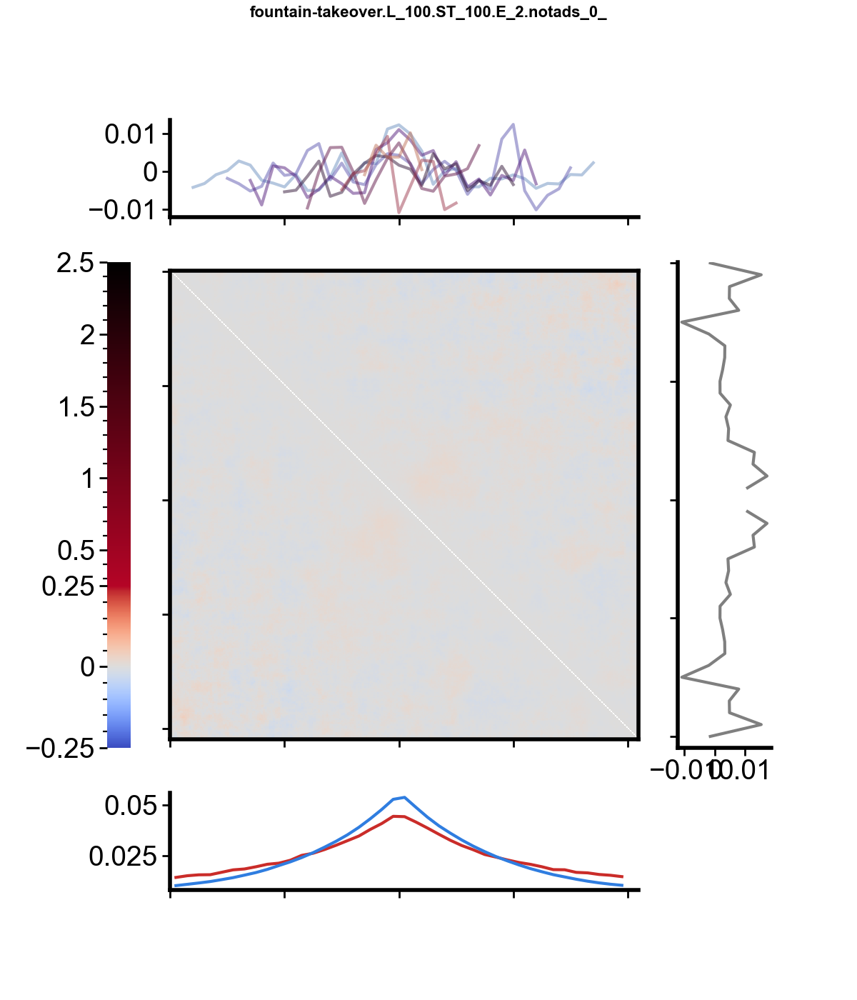

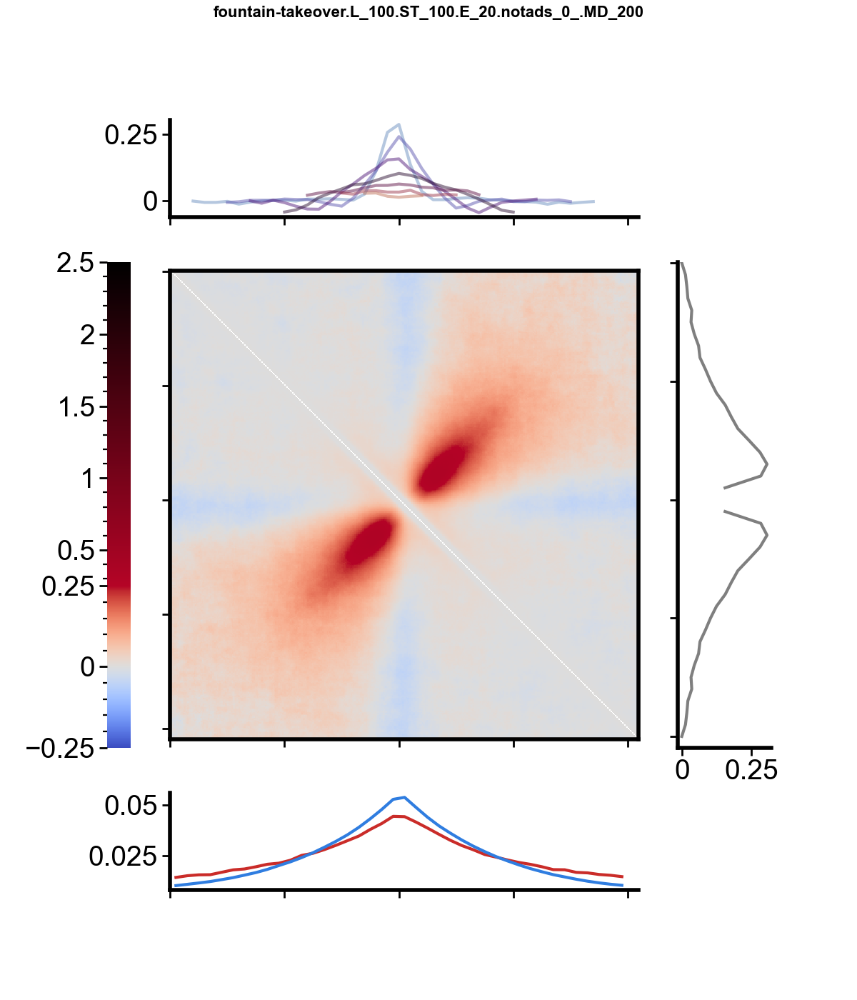

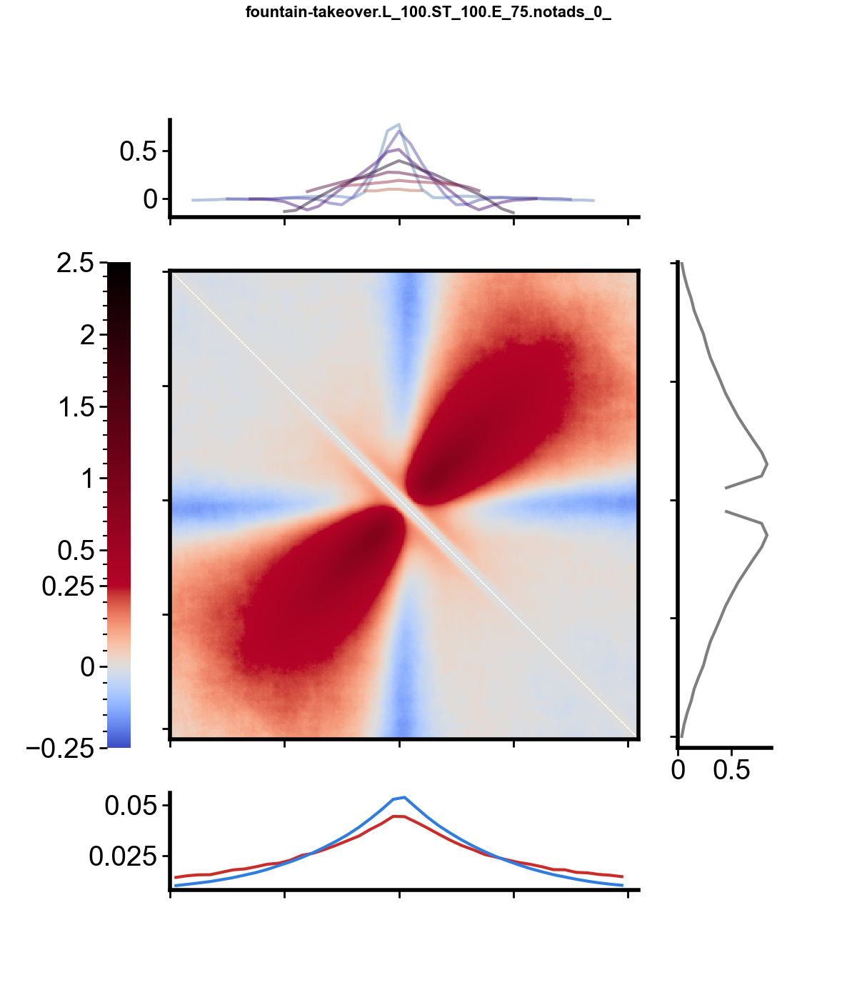

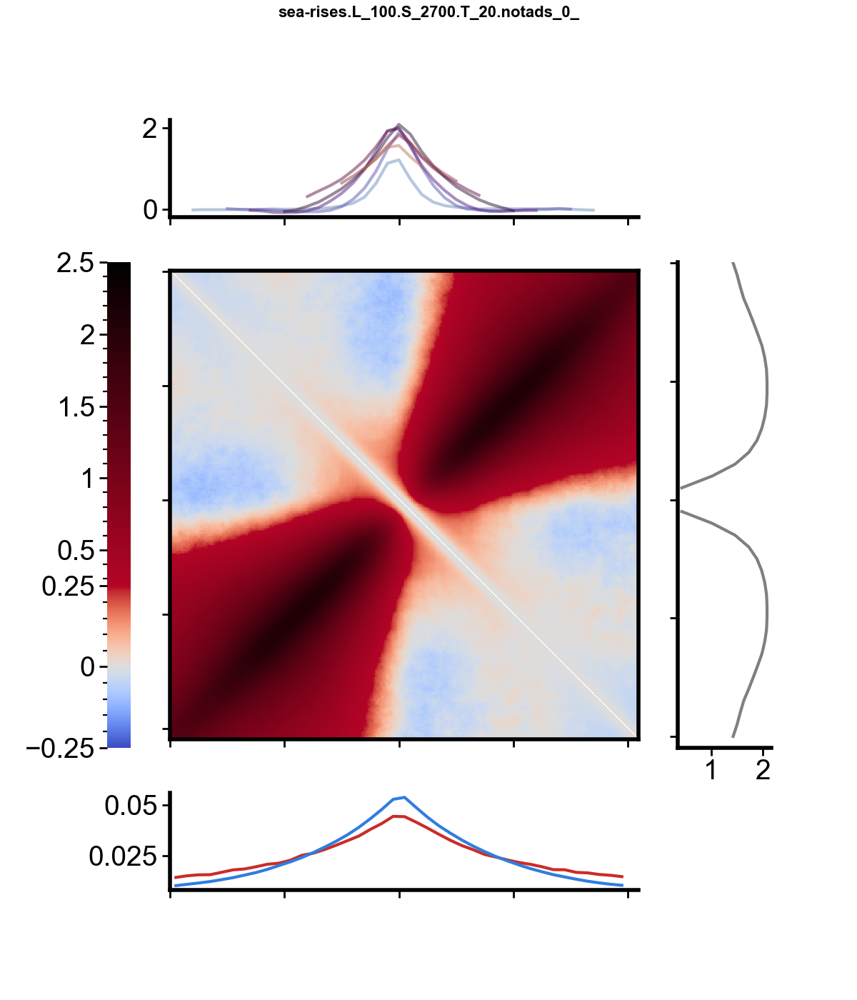

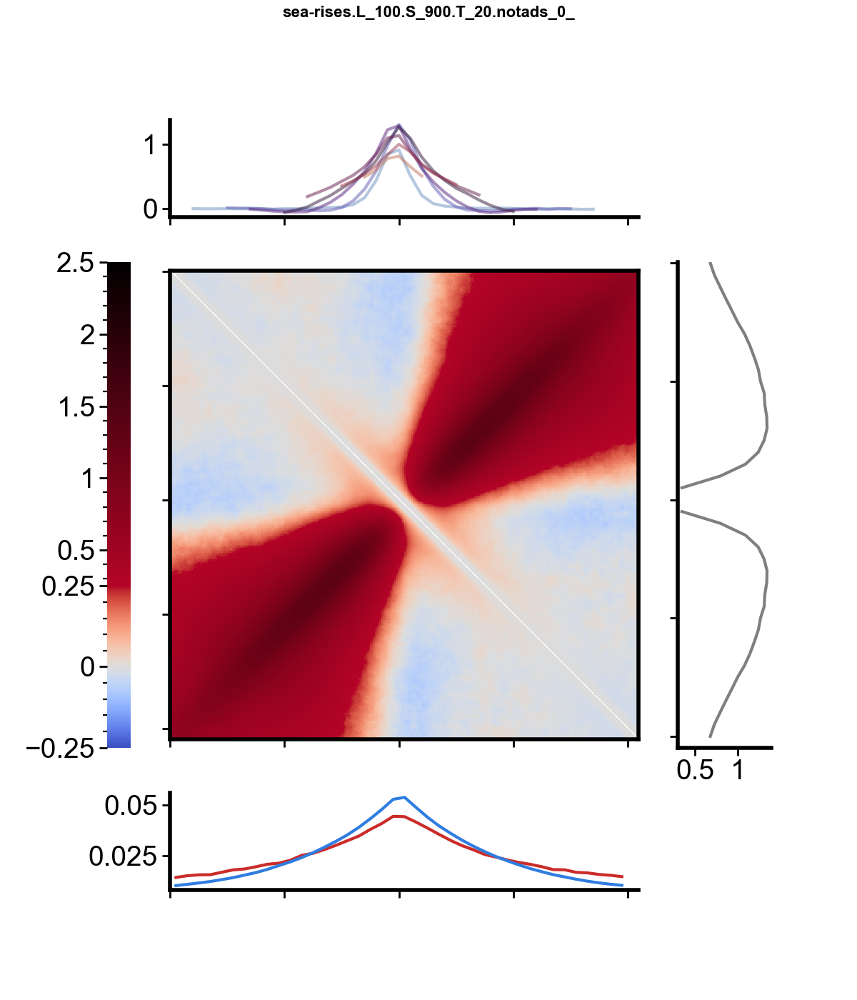

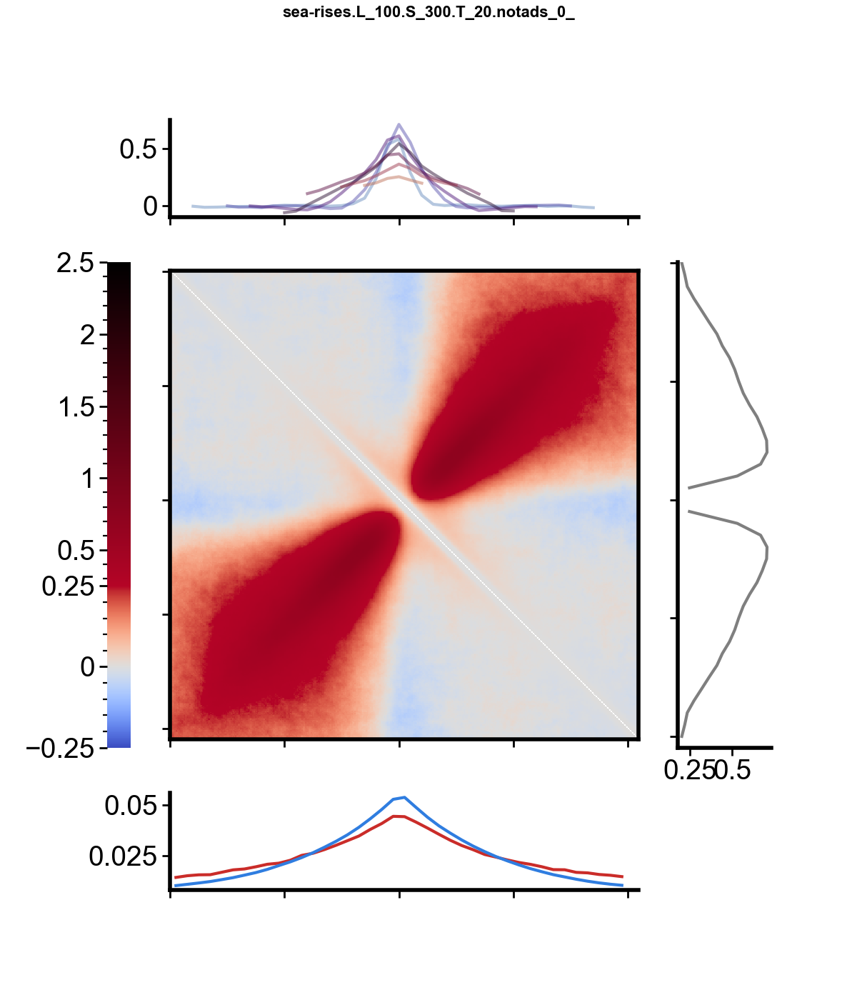

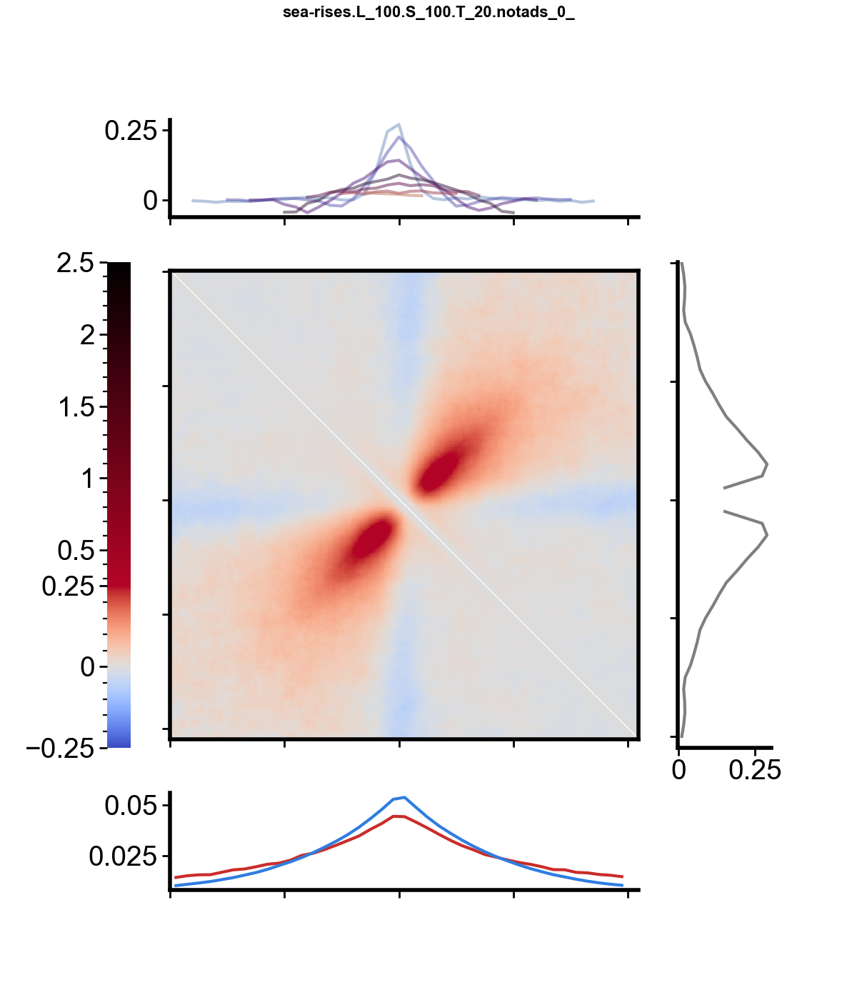

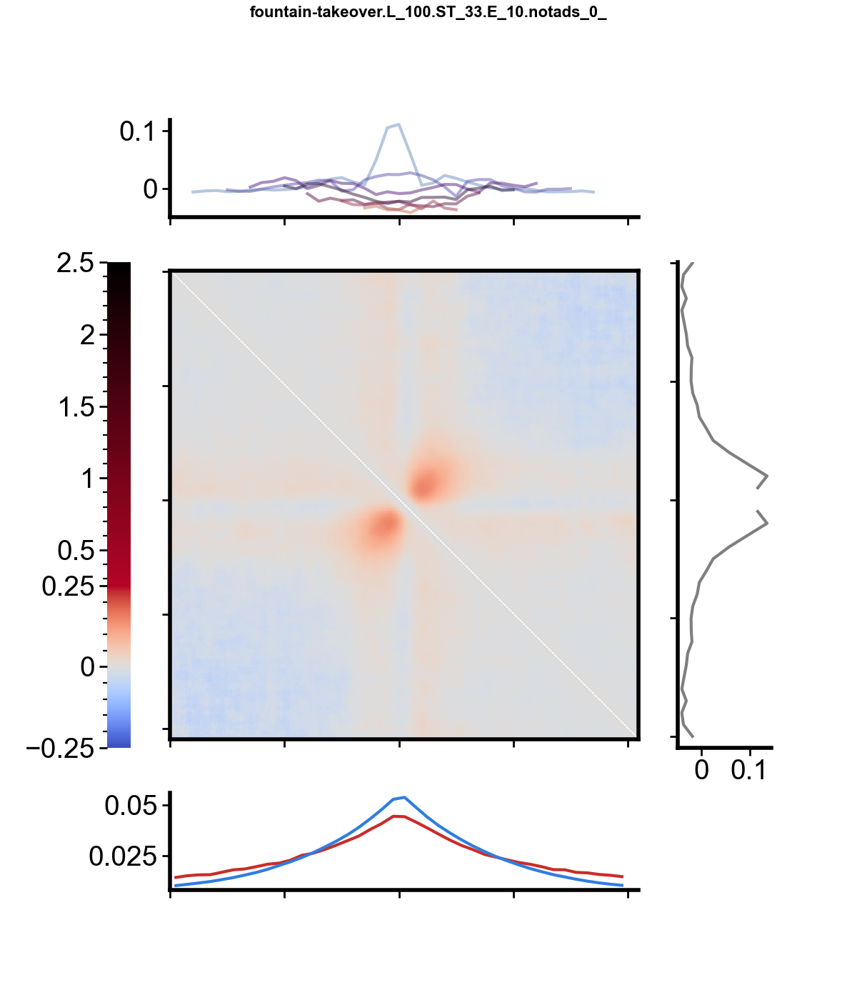

In [556]:
for i, position, df, colorscale in toplot:
    for prefix, r in df.iterrows():
        print(i, prefix)
        enrichment = r["enrichment"]
        separation = r["separation"]
        vmin, vmax1, vmax2 = colorscale

        try:
            (
                pile_3d,
                pile_3d_agg,
                offdiag_3d,
                offdiag_3d_agg,
                protractor_3d,
                crosssec_3d,
            ) = dict_3d[prefix]
            # coh_profile, coh_profile_pile, coh_profile_t, coh_profile_pile_t = dict_1d[prefix]

            # coh_profile_upd   = np.sum(coh_profile_pile.reshape(-1, 10), axis=1)
            # coh_profile_upd_t = np.sum(coh_profile_pile_t.reshape(-1, 10), axis=1)

            fig = plot_sim_summary(
                pile_3d,
                crosssec_3d,
                protractor_3d,
                coh_profile_upd,
                coh_profile_upd_t,
                resolution=10000,
                vmin=vmin,
                vmax_scale1=vmax1,
                vmax_scale2=vmax2,
            )
            fig.suptitle(prefix, fontsize=8)

            if do_save:
                output_file = f"{output_folder}/Fig5-SFig5_profiles/SFig5A_{i}_profile_{prefix}.pdf"
                fig.savefig(output_file)

            # plt.close('all')
        except Exception as e:
            print(prefix, e)

In [557]:
# Plot profiles for Suppl. Figures 6
toplot = [
    # SFig6A:
    (
        0,
        "1",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==100 and enrichment==1'
        ),
        (-0.25, 0.25, 1),
    ),
    (
        1,
        "2",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==100 and enrichment==10'
        ),
        (-0.25, 0.25, 1),
    ),
    (
        2,
        "3",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==100 and enrichment==50'
        ),
        (-0.25, 0.25, 1),
    ),
    (
        3,
        "4",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==100 and enrichment==100'
        ),
        (-0.25, 0.25, 1),
    ),
    (
        4,
        "5",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==100 and enrichment==200'
        ),
        (-0.25, 0.25, 1),
    ),
    # SFig6B:
    (
        6,
        "7",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==66 and enrichment==10'
        ),
        (-0.25, 0.25, 1),
    ),
    (
        7,
        "8",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==66 and enrichment==50'
        ),
        (-0.25, 0.25, 1),
    ),
    (
        8,
        "9",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==66 and enrichment==100'
        ),
        (-0.25, 0.25, 1),
    ),
    # SFig6C:
    (
        9,
        "10",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==50 and enrichment==20'
        ),
        (-0.25, 0.25, 1),
    ),
    (
        10,
        "11",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==50 and enrichment==50'
        ),
        (-0.25, 0.25, 1),
    ),
    # SFig6D:
    (
        11,
        "12",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==33 and enrichment==10'
        ),
        (-0.1, 0.1, 0.5),
    ),
    (
        12,
        "13",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==44 and enrichment==10'
        ),
        (-0.1, 0.1, 0.5),
    ),
    # SFig6E:
    (
        13,
        "14",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==200 and enrichment==10'
        ),
        (-0.2, 0.2, 0.75),
    ),
    (
        14,
        "15",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==200 and enrichment==50'
        ),
        (-0.2, 0.2, 0.75),
    ),
    (
        15,
        "16",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==500 and enrichment==10'
        ),
        (-0.2, 0.2, 0.75),
    ),
    (
        16,
        "17",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==500 and enrichment==50'
        ),
        (-0.2, 0.2, 0.75),
    ),
    (
        17,
        "18",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==900 and enrichment==10'
        ),
        (-0.2, 0.2, 0.75),
    ),
    (
        18,
        "19",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==900 and enrichment==50'
        ),
        (-0.2, 0.2, 0.75),
    ),
]

0 fountain-takeover.L_100.ST_100.E_1.0.notads_0_
1 fountain-takeover.L_100.ST_100.E_10.notads_0_
2 fountain-takeover.L_100.ST_100.E_50.notads_0_
3 fountain-takeover.L_100.ST_100.E_100.notads_0_
4 fountain-takeover.L_100.ST_100.E_200.notads_0_
6 fountain-takeover.L_100.ST_66.E_10.notads_0_
7 fountain-takeover.L_100.ST_66.E_50.notads_0_
8 fountain-takeover.L_100.ST_66.E_100.notads_0_
9 fountain-takeover.L_100.ST_50.E_20.notads_0_
10 fountain-takeover.L_100.ST_50.E_50.notads_0_
11 fountain-takeover.L_100.ST_33.E_10.notads_0_
12 fountain-takeover.L_100.ST_44.E_10.notads_0_
13 fountain-takeover.L_100.ST_200.E_10.notads_0_
14 fountain-takeover.L_100.ST_200.E_50.notads_0_
15 fountain-takeover.L_100.ST_500.E_10.notads_0_
16 fountain-takeover.L_100.ST_500.E_50.notads_0_
17 fountain-takeover.L_100.ST_900.E_10.notads_0_
18 fountain-takeover.L_100.ST_900.E_50.notads_0_


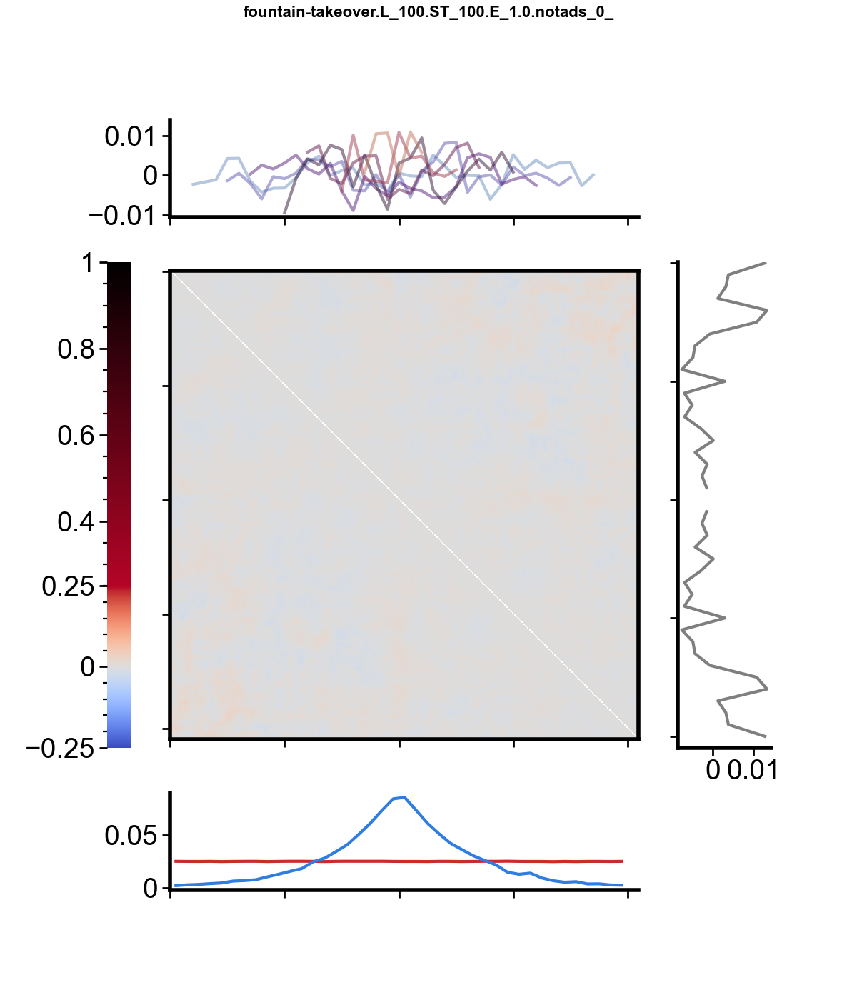

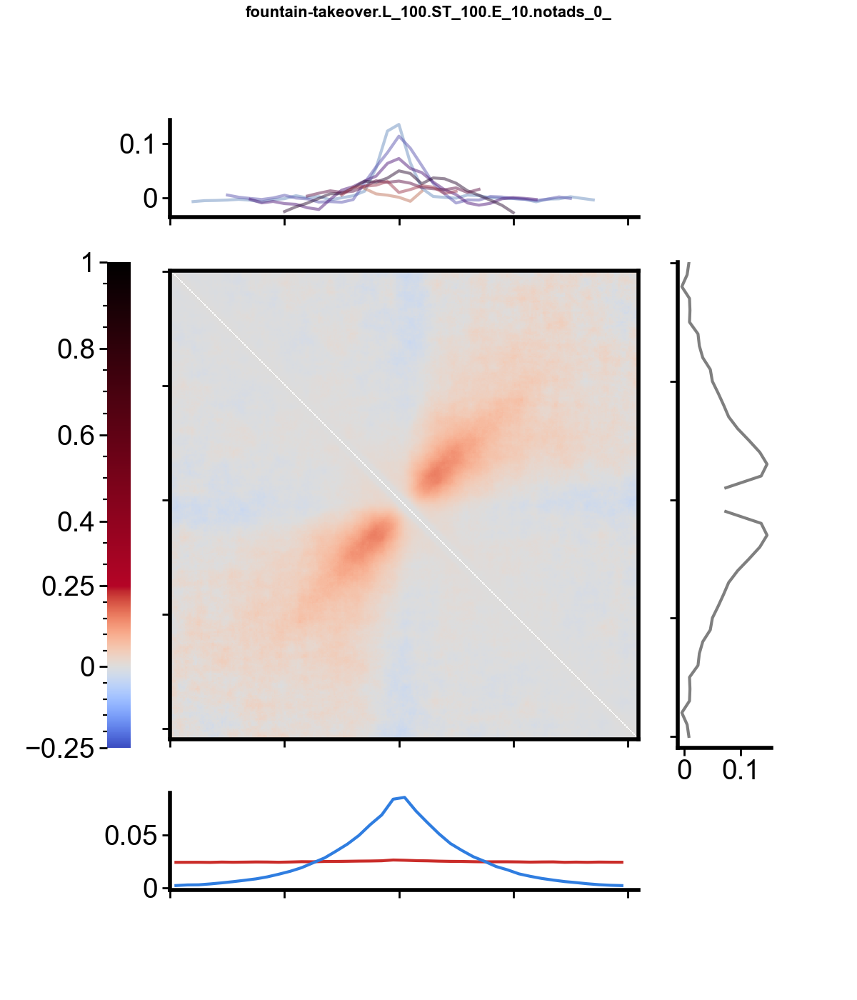

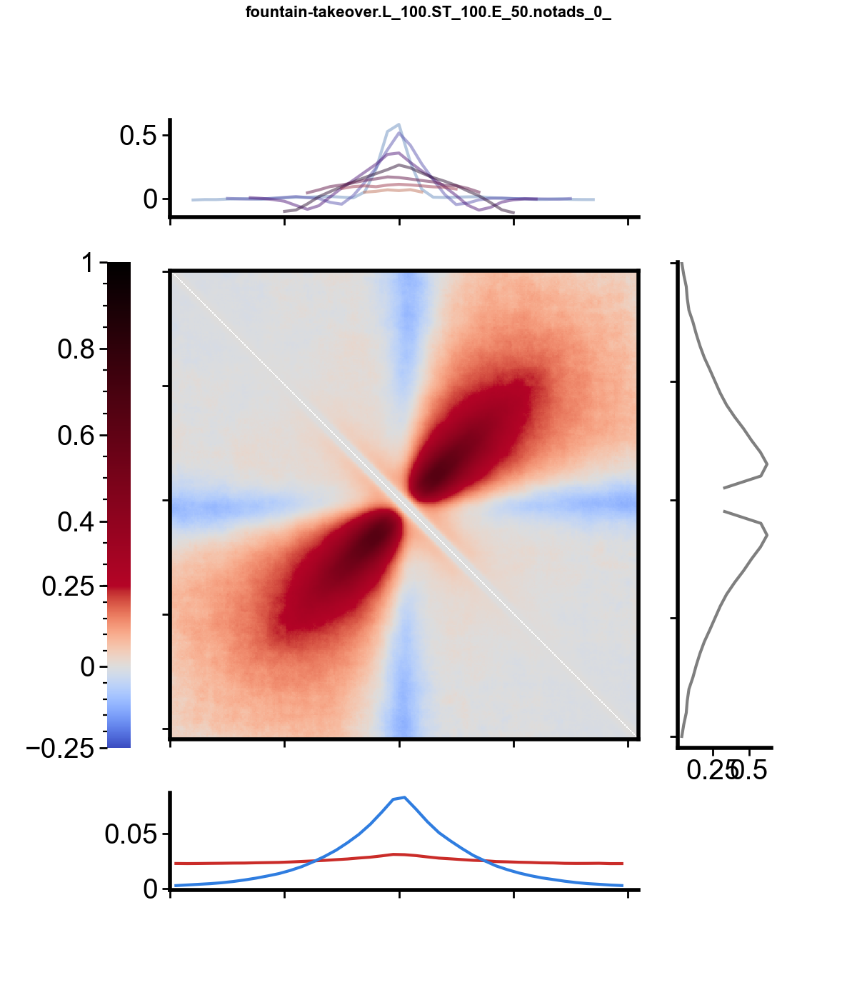

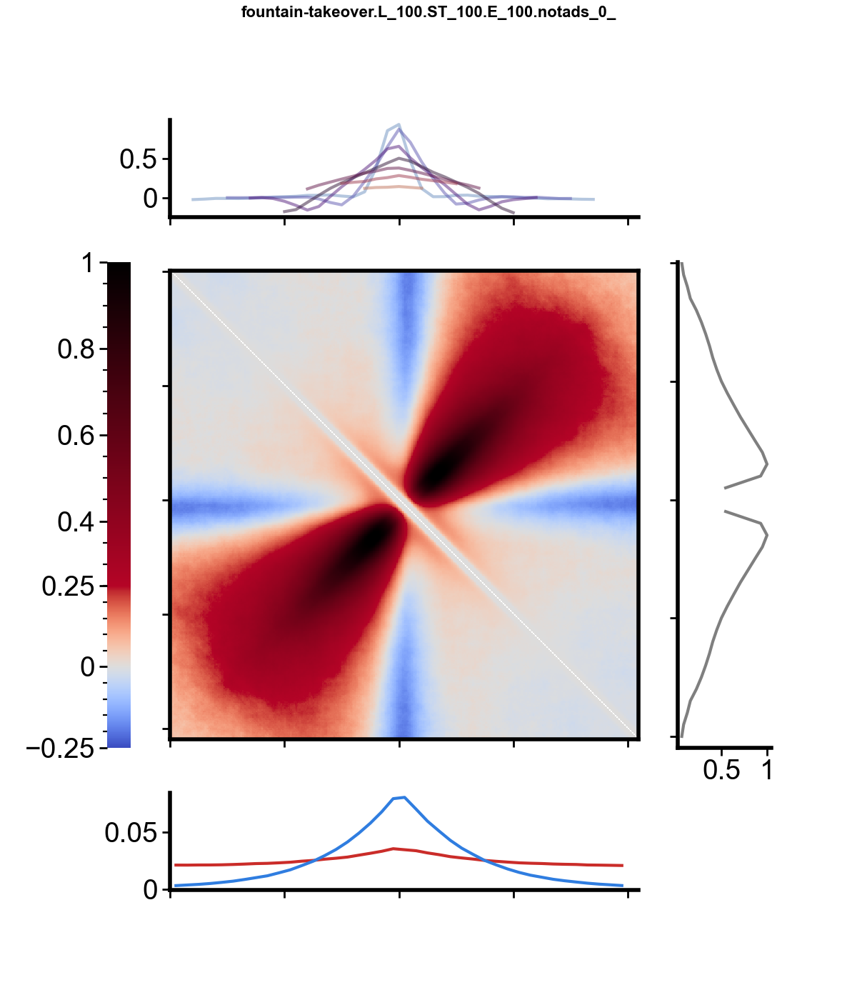

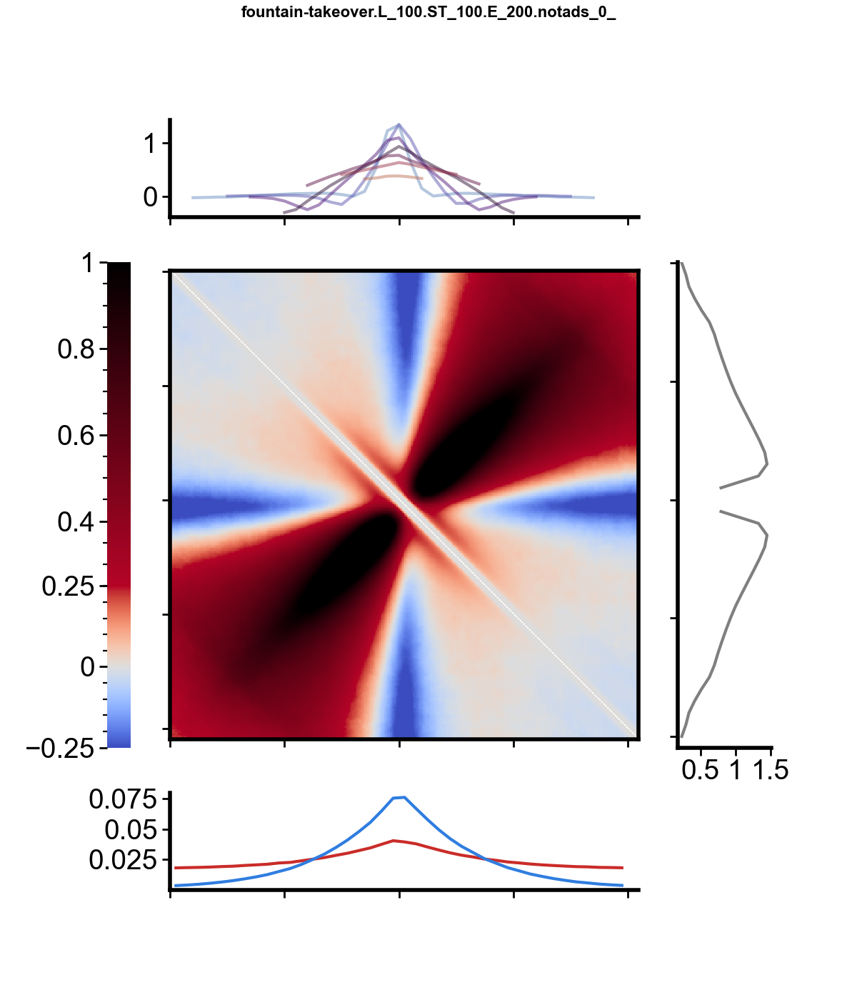

...

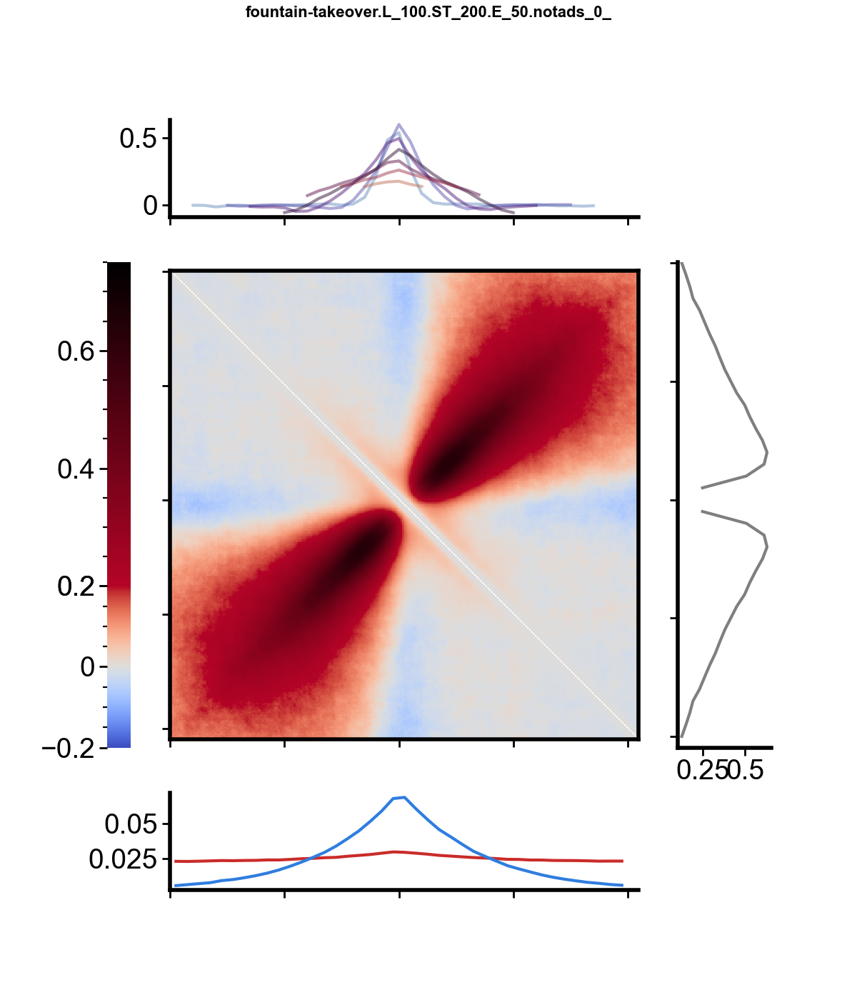

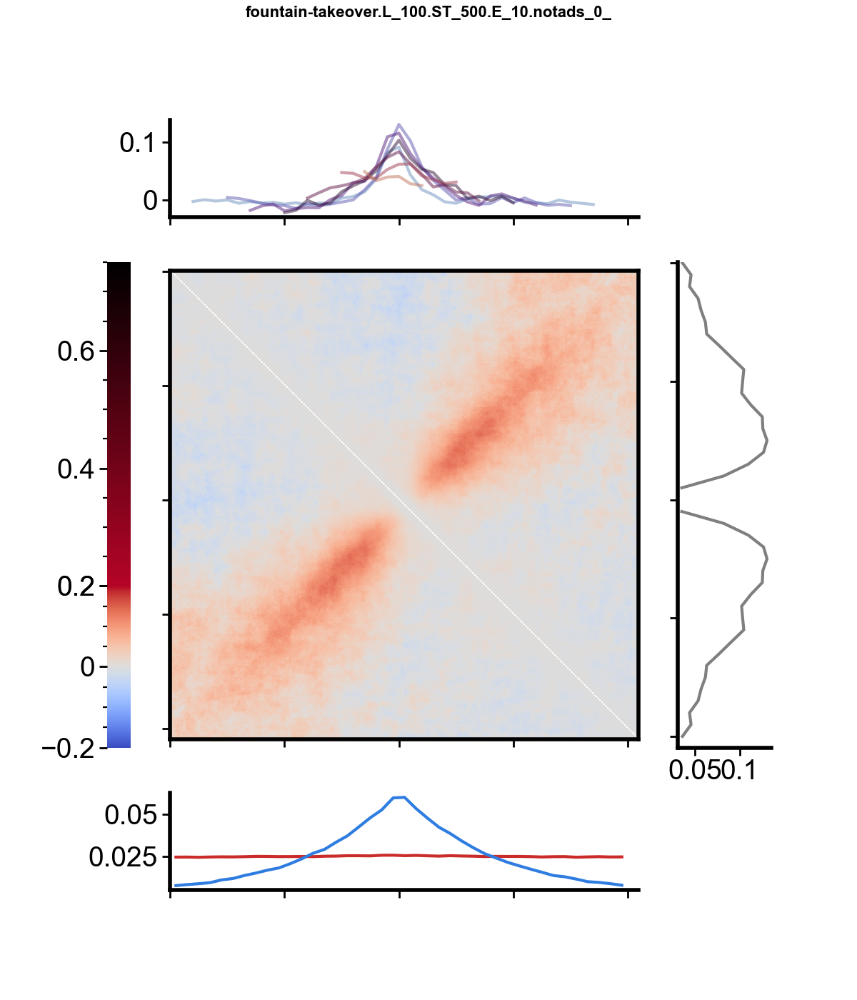

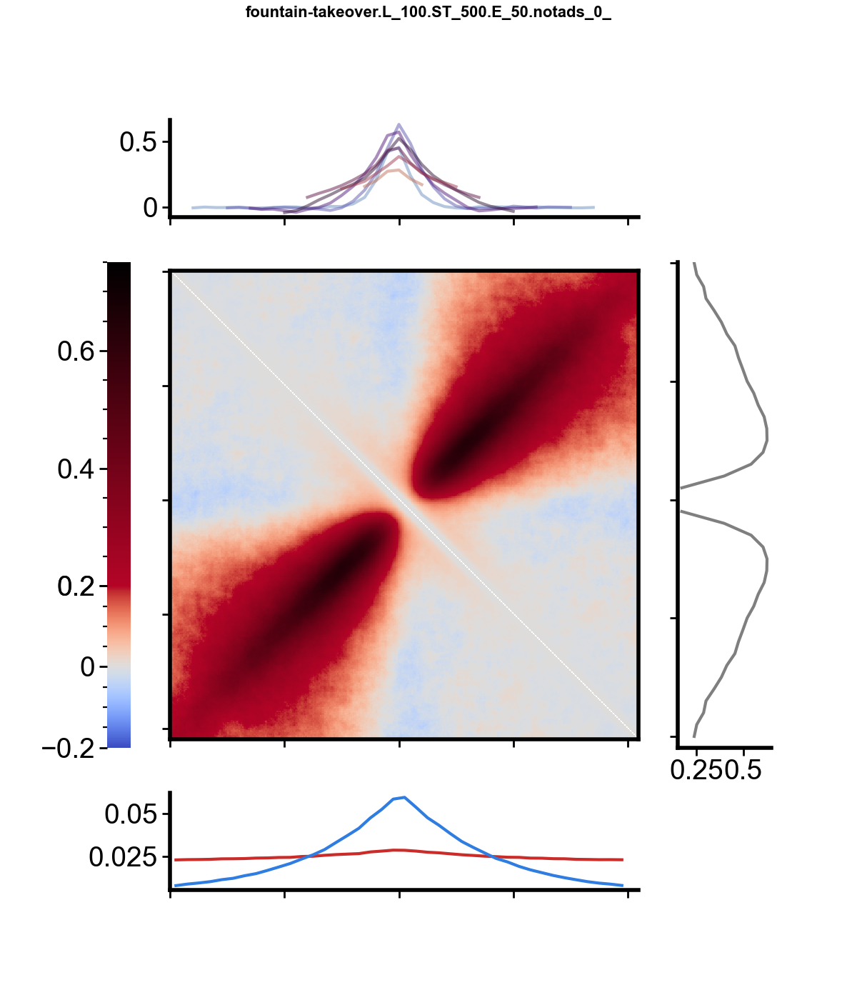

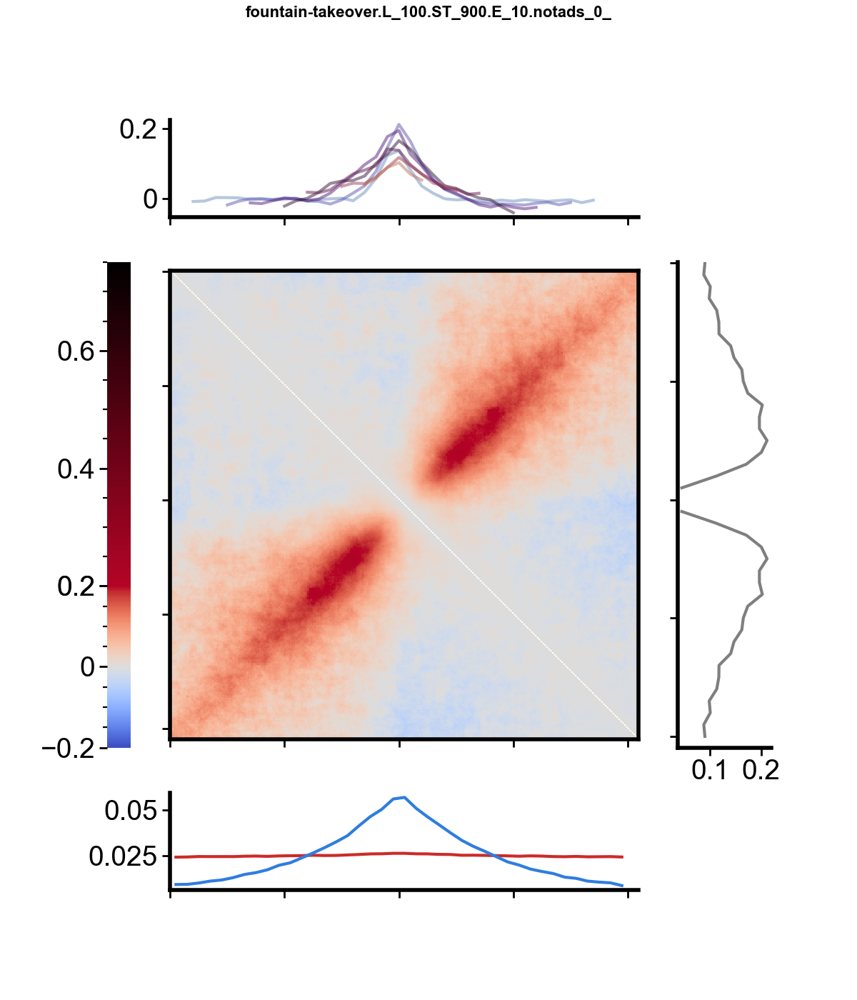

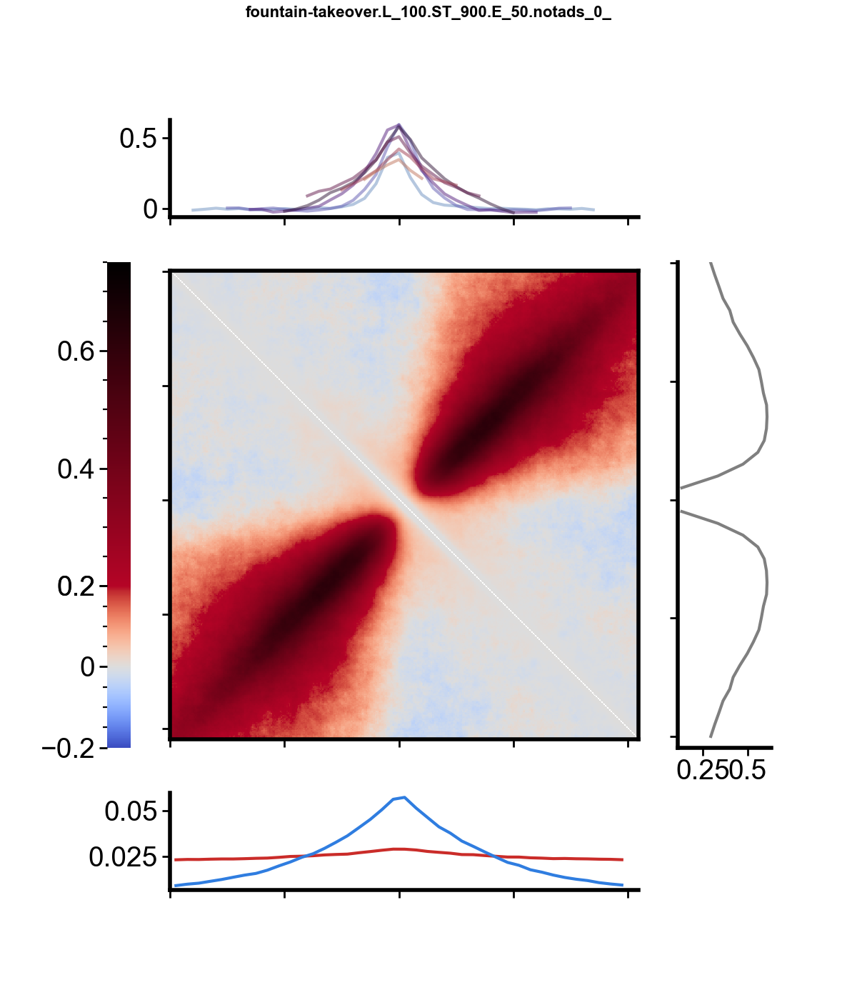

In [558]:
for i, position, df, colorscale in toplot:
    for prefix, r in df.iterrows():
        print(i, prefix)
        enrichment = r["enrichment"]
        separation = r["separation"]
        vmin, vmax1, vmax2 = colorscale

        try:
            (
                pile_3d,
                pile_3d_agg,
                offdiag_3d,
                offdiag_3d_agg,
                protractor_3d,
                crosssec_3d,
            ) = dict_3d[prefix]
            coh_profile, coh_profile_pile, coh_profile_t, coh_profile_pile_t = dict_1d[
                prefix
            ]

            coh_profile_upd = np.sum(coh_profile_pile.reshape(-1, 10), axis=1)
            coh_profile_upd_t = np.sum(coh_profile_pile_t.reshape(-1, 10), axis=1)

            fig = plot_sim_summary(
                pile_3d,
                crosssec_3d,
                protractor_3d,
                coh_profile_upd,
                coh_profile_upd_t,
                resolution=10000,
                vmin=vmin,
                vmax_scale1=vmax1,
                vmax_scale2=vmax2,
            )
            fig.suptitle(prefix, fontsize=8)

            if do_save:
                output_file = f"{output_folder}/Fig5-SFig5_profiles/SFig6_{i}_profile_{prefix}.pdf"
                fig.savefig(output_file)

            # plt.close('all')
        except Exception as e:
            print(prefix, e)

In [559]:
# Plot profiles for Suppl. Figures 5C
toplot = [
    # SFig5C:
    (
        0,
        "1",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==100 and enrichment==10'
        ),
        (-0.2, 0.2, 1),
    ),
    (
        1,
        "2",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==900 and enrichment==10'
        ),
        (-0.2, 0.2, 1),
    ),
]

0 fountain-takeover.L_100.ST_100.E_10.notads_0_
1 fountain-takeover.L_100.ST_900.E_10.notads_0_


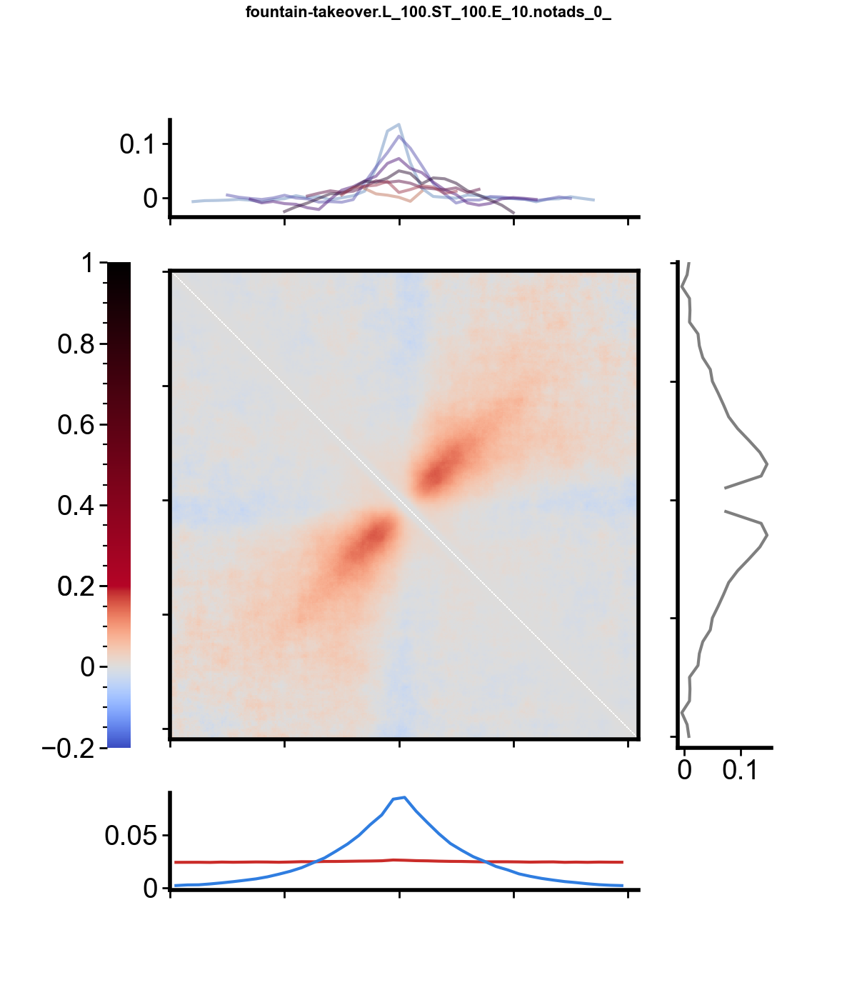

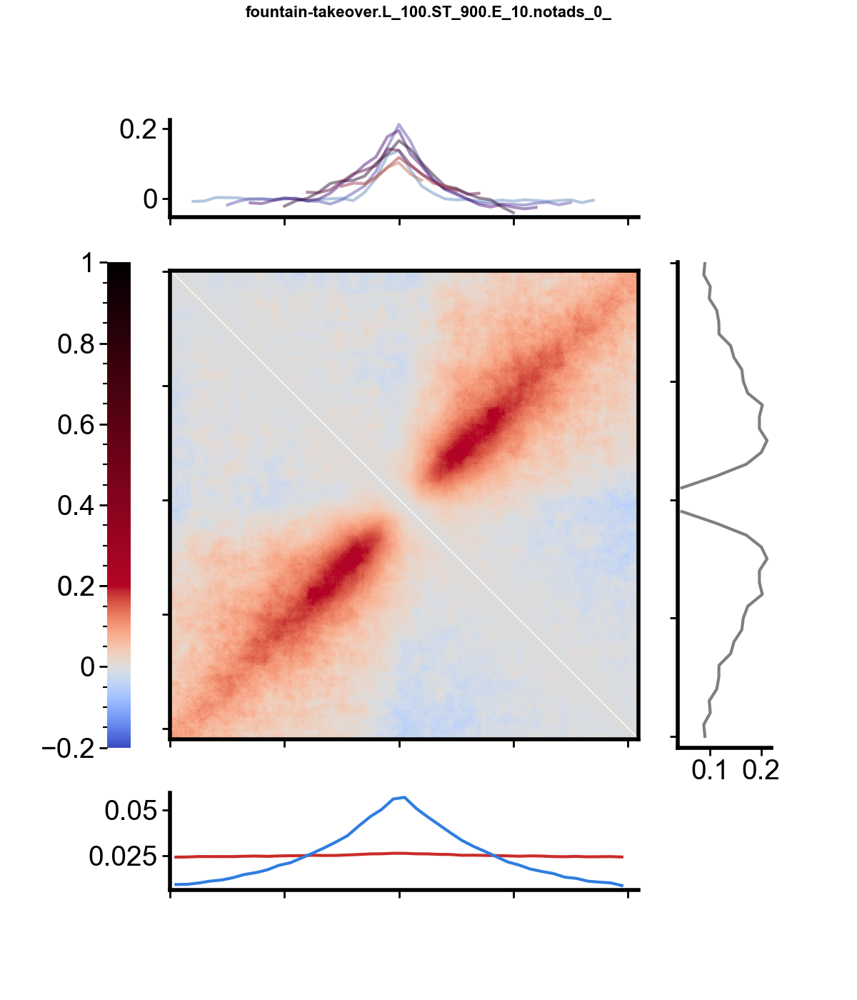

In [560]:
for i, position, df, colorscale in toplot:
    for prefix, r in df.iterrows():
        print(i, prefix)
        enrichment = r["enrichment"]
        separation = r["separation"]
        vmin, vmax1, vmax2 = colorscale

        try:
            (
                pile_3d,
                pile_3d_agg,
                offdiag_3d,
                offdiag_3d_agg,
                protractor_3d,
                crosssec_3d,
            ) = dict_3d[prefix]
            coh_profile, coh_profile_pile, coh_profile_t, coh_profile_pile_t = dict_1d[
                prefix
            ]

            coh_profile_upd = np.sum(coh_profile_pile.reshape(-1, 10), axis=1)
            coh_profile_upd_t = np.sum(coh_profile_pile_t.reshape(-1, 10), axis=1)

            fig = plot_sim_summary(
                pile_3d,
                crosssec_3d,
                protractor_3d,
                coh_profile_upd,
                coh_profile_upd_t,
                resolution=10000,
                vmin=vmin,
                vmax_scale1=vmax1,
                vmax_scale2=vmax2,
            )
            fig.suptitle(prefix, fontsize=8)

            if do_save:
                output_file = f"{output_folder}/Fig5-SFig5_profiles/SFig5C_{i}_profile_{prefix}.pdf"
                fig.savefig(output_file)

            # plt.close('all')
        except Exception as e:
            print(prefix, e)

#### Cross-sections of real and simulated fountains (Fig. 5c)

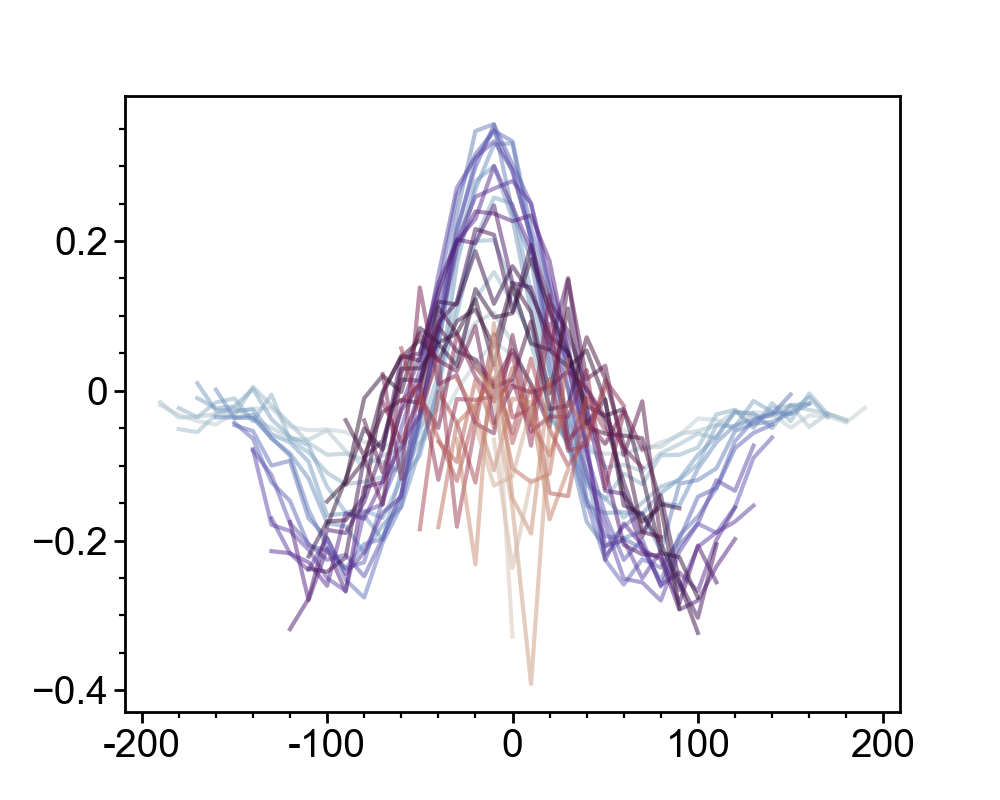

In [548]:
fig, ax = plt.subplots(1, 1, figsize=[5, 4])

plot_cros_sections(crosssec_reference, each=1, ax=ax)

set_genomic_ticks(
    ax,
    on_axes="x",
    flank=200000,
    resolution=10000,
    aggcoef=10,
    withlabels=False,
)

if do_save:
    output_file = f"{output_folder}/SFig5C_crosssection_reference.pdf"
    fig.savefig(output_file)

In [549]:
if do_save:
    agg_coef = 1

    records = []

    for sec_id, section in enumerate(crosssec_reference):
        # make sure it's a 1D numpy array
        section = np.asarray(section, dtype=float).ravel()
        n_bins = section.size

        # bin indices within this cross-section
        bin_idx = np.arange(n_bins)

        # relative genomic positions (0 at center, in bp and kb)
        rel_pos_bp = (bin_idx - (n_bins - 1) / 2.0) * resolution
        rel_pos_kb = rel_pos_bp / 1_000.0

        # x positions in "plot units" (what matplotlib sees when i == 0)
        x_plot = agg_coef * bin_idx

        df_sec = pd.DataFrame(
            {
                "section_id": sec_id,
                "bin_index": bin_idx,
                "x_plot": x_plot,
                "rel_position_bp": rel_pos_bp,
                "rel_position_kb": rel_pos_kb,
                "value": section,
            }
        )
        records.append(df_sec)

    df_crosssections = pd.concat(records, ignore_index=True)
    df_crosssections = df_crosssections.pivot(
        columns="rel_position_kb", index="section_id", values="value"
    )

    if do_save:
        data_file = f"{output_folder}/SFig5C_crosssection_reference_data.tsv"
        df_crosssections.to_csv(data_file, sep="\t", index=False)
        print("Saved cross-section data to:", data_file)

Saved cross-section data to: ./results_2025-12-03_AxG_simulations/SFig5C_crosssection_reference_data.tsv


In [550]:
# plot profiles for Suppl. Figures 6a
toplot = [
    (
        0,
        "mid",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==900 and enrichment==10'
        ),
        (-0.25, 0.25, 2.5),
    ),
    (
        1,
        "right",
        df_all.query(
            'mode=="fountain-takeover" and lifetime==100 and separation==100 and enrichment==10'
        ),
        (-0.25, 0.25, 2.5),
    ),
]

aggcoef = 1

0 fountain-takeover.L_100.ST_900.E_10.notads_0_
1 fountain-takeover.L_100.ST_100.E_10.notads_0_


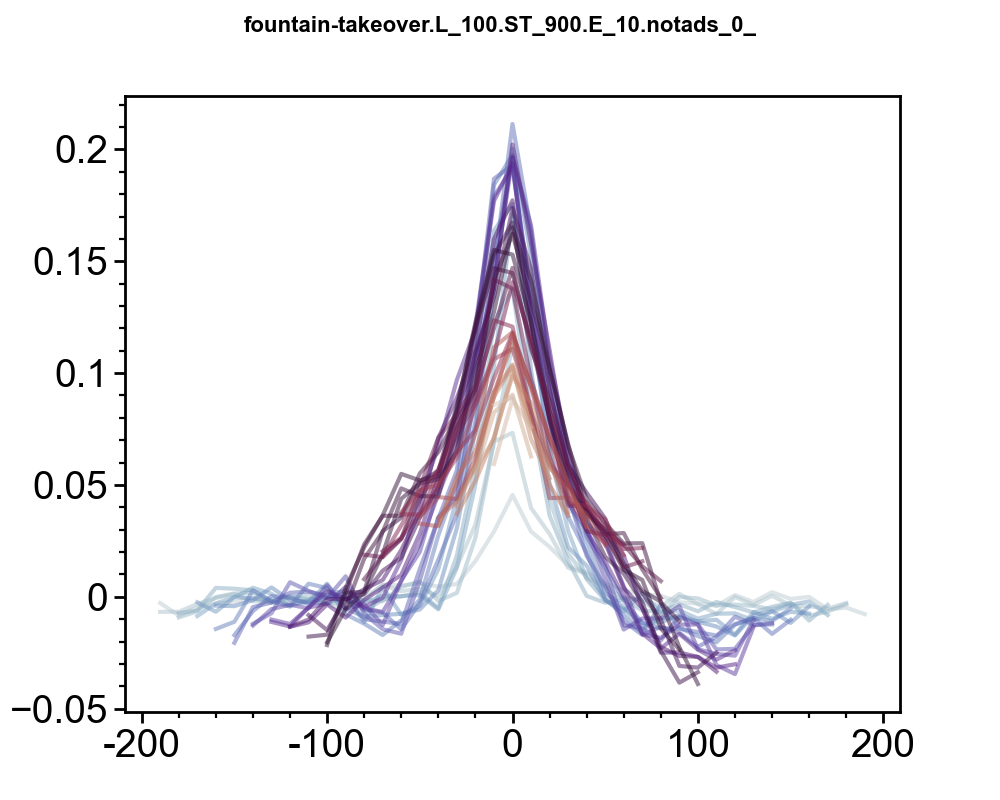

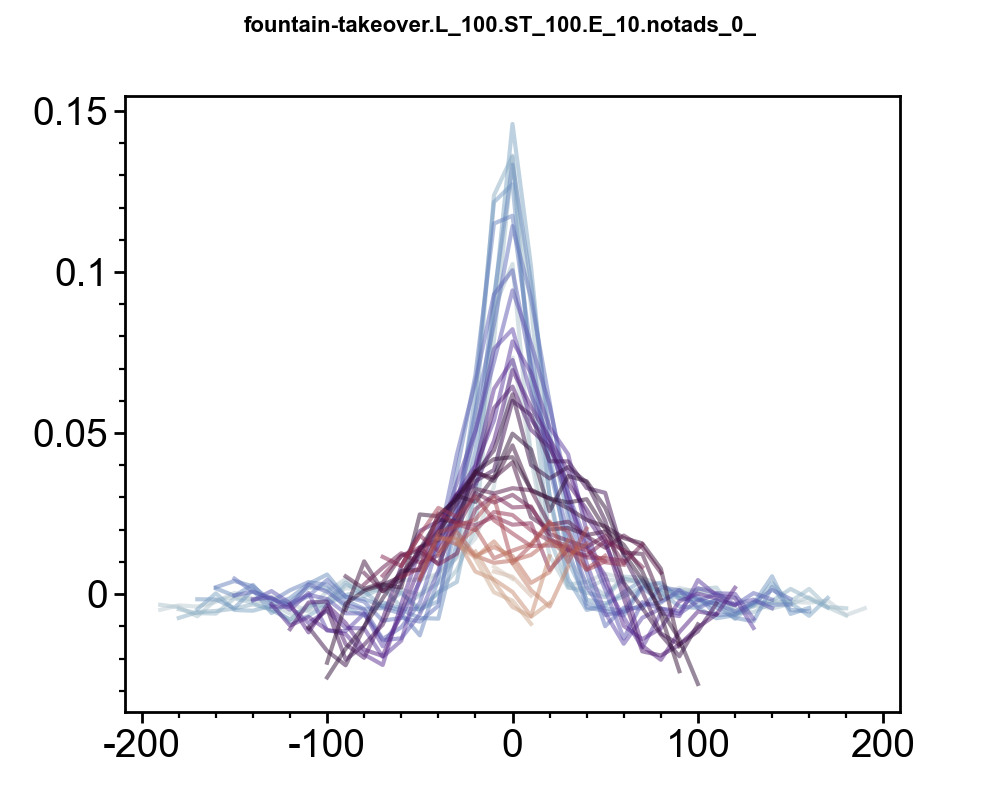

In [551]:
for i, position, df, colorscale in toplot:
    for prefix, r in df.iterrows():
        print(i, prefix)
        enrichment = r["enrichment"]
        separation = r["separation"]
        vmin, vmax1, vmax2 = colorscale

        try:
            output_file = f"{output_folder}/Fig5-SFig5_profiles/profile_{prefix}.pdf"
            if True:  # not os.path.isfile(output_file):
                (
                    pile_3d,
                    pile_3d_agg,
                    offdiag_3d,
                    offdiag_3d_agg,
                    protractor_3d,
                    crosssec_3d,
                ) = dict_3d[prefix]
                # coh_profile, coh_profile_pile, coh_profile_t, coh_profile_pile_t = dict_1d[prefix]

                # coh_profile_upd   = np.sum(coh_profile_pile.reshape(-1, 10), axis=1)
                # coh_profile_upd_t = np.sum(coh_profile_pile_t.reshape(-1, 10), axis=1)

                fig, ax = plt.subplots(1, 1, figsize=[5, 4])

                plot_cros_sections(crosssec_3d, each=aggcoef, ax=ax)

                set_genomic_ticks(
                    ax,
                    on_axes="x",
                    flank=200000,
                    resolution=10000,
                    aggcoef=10,
                    withlabels=False,
                )
                fig.suptitle(prefix, fontsize=8)

                if do_save:
                    output_file = f"{output_folder}/SFig5C_crosssection_{prefix}.pdf"
                    fig.savefig(output_file)

                # plt.close('all')
        except Exception as e:
            print(prefix, e)

In [552]:
if do_save:
    for i, position, df, colorscale in toplot:
        for prefix, r in df.iterrows():
            print(i, prefix)

            (
                pile_3d,
                pile_3d_agg,
                offdiag_3d,
                offdiag_3d_agg,
                protractor_3d,
                crosssec_3d,
            ) = dict_3d[prefix]
            agg_coef = 1

            records = []

            for sec_id, section in enumerate(crosssec_reference):
                # make sure it's a 1D numpy array
                section = np.asarray(section, dtype=float).ravel()
                n_bins = section.size

                # bin indices within this cross-section
                bin_idx = np.arange(n_bins)

                # relative genomic positions (0 at center, in bp and kb)
                rel_pos_bp = (bin_idx - (n_bins - 1) / 2.0) * resolution
                rel_pos_kb = rel_pos_bp / 1_000.0

                # x positions in "plot units" (what matplotlib sees when i == 0)
                x_plot = agg_coef * bin_idx

                df_sec = pd.DataFrame(
                    {
                        "section_id": sec_id,
                        "bin_index": bin_idx,
                        "x_plot": x_plot,
                        "rel_position_bp": rel_pos_bp,
                        "rel_position_kb": rel_pos_kb,
                        "value": section,
                    }
                )
                records.append(df_sec)

            df_crosssections = pd.concat(records, ignore_index=True)
            df_crosssections = df_crosssections.pivot(
                columns="rel_position_kb", index="section_id", values="value"
            )

            if do_save:
                data_file = f"{output_folder}/SFig5C_crosssection_{prefix}.tsv"
                df_crosssections.to_csv(data_file, sep="\t", index=False)
                print("Saved cross-section data to:", data_file)

0 fountain-takeover.L_100.ST_900.E_10.notads_0_
Saved cross-section data to: ./results_2025-12-03_AxG_simulations/SFig5C_crosssection_fountain-takeover.L_100.ST_900.E_10.notads_0_.tsv
1 fountain-takeover.L_100.ST_100.E_10.notads_0_
Saved cross-section data to: ./results_2025-12-03_AxG_simulations/SFig5C_crosssection_fountain-takeover.L_100.ST_100.E_10.notads_0_.tsv


In [47]:
section_flush()

✅ Section cleaned


### Realistic simulations: comparison of protractor and cross-sections (SFig.  8)

In [561]:
section_start()

✅ Section started


In [585]:
colors_dct = {
    "cross-section high CTCF": "#8dc63f",
    "cross-section low CTCF": "#8cb8c6",
    "protractor high CTCF": "#ed1d24",
    "protractor low CTCF": "#e495a5",
}

In [563]:
folder_pileups = "/home/agalicina/DANIO/HIC/WD_2021_paper/15_Blobel/data/pileups/"
mask_pileups = f"{folder_pileups}/*.npy"
files = glob.glob(mask_pileups)

In [582]:
dict_mesc = {}

for f in tqdm.tqdm(files):

    pile_3d = np.load(f)
    window = 1000
    aggcoef = 10
    pile_3d_agg = numutils.zoom_array(pile_3d, (window // aggcoef, window // aggcoef))

    protractor_3d = return_full_protractor(np.log2(pile_3d_agg))
    crosssec_3d = return_cross_sections(np.log2(pile_3d_agg))

    name = f.split("/")[-1].split(".")[0]
    dict_mesc[name] = [
        pile_3d.copy(),
        pile_3d_agg.copy(),
        protractor_3d.copy(),
        crosssec_3d.copy(),
    ]

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 114.69it/s]


Creating new figure...
Creating new figure...


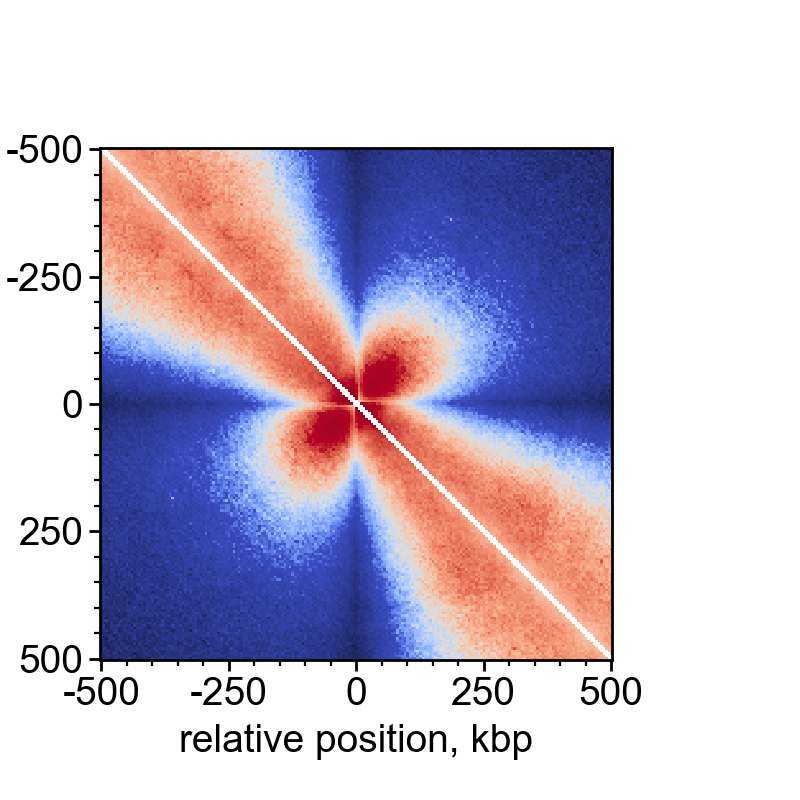

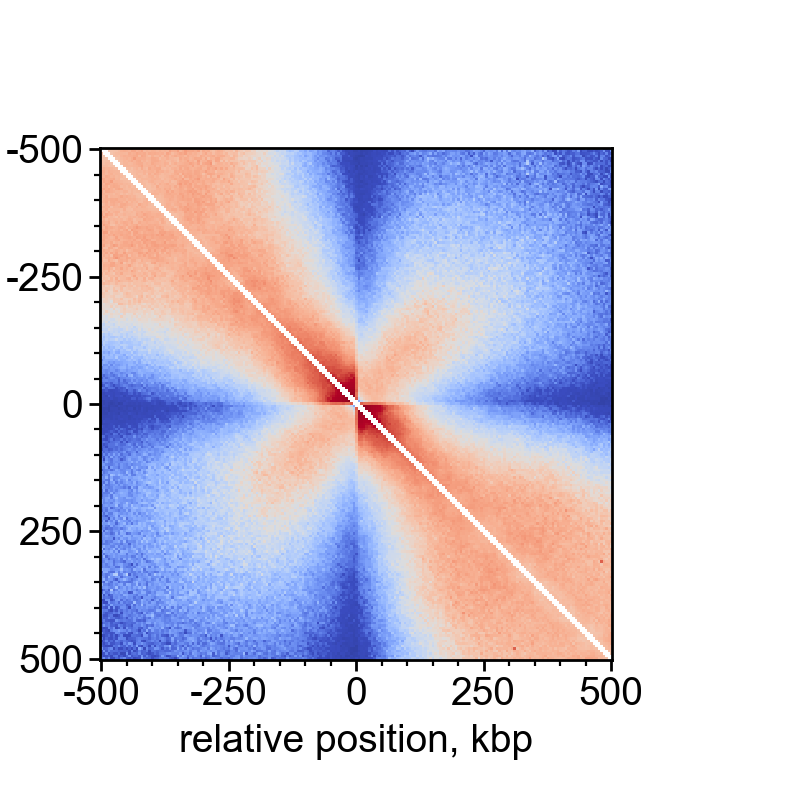

In [584]:
# Elements for Fig. 8a are already stored in another notebook, so let's just inspect it:
factor1 = 0.18
factor2 = 0.8

fig = plot_heatmap_three_scales(
    np.log2(dict_mesc["pileup_w500Kb_r5Kb_dCTCF_UT"][0]),
    vmin_scale2=-factor2,
    vmin_scale1=-factor1,
    vmax_scale1=factor1,
    vmax_scale2=factor2,
    flank=500000,
    resolution=5000,
    interpolation="none",
    withlabels=True,
    cmap="coolwarm",
    cbar=False,
    log=False,
)

fig = plot_heatmap_three_scales(
    np.log2(dict_mesc["pileup_w500Kb_r5Kb_dCTCF_IAA"][0]),
    vmin_scale2=-factor2,
    vmin_scale1=-factor1,
    vmax_scale1=factor1,
    vmax_scale2=factor2,
    flank=500000,
    resolution=5000,
    interpolation="none",
    withlabels=True,
    cmap="coolwarm",
    cbar=False,
    log=False,
)

##### Plot cross-sections and protractor for real data (SFig. 8a right)

In [626]:
output = []

Saved cross-section view to: /net/levsha/share/agalicina/simulations/chromatin_fountains//data/snippets//SFig8a-right_crossections.pdf


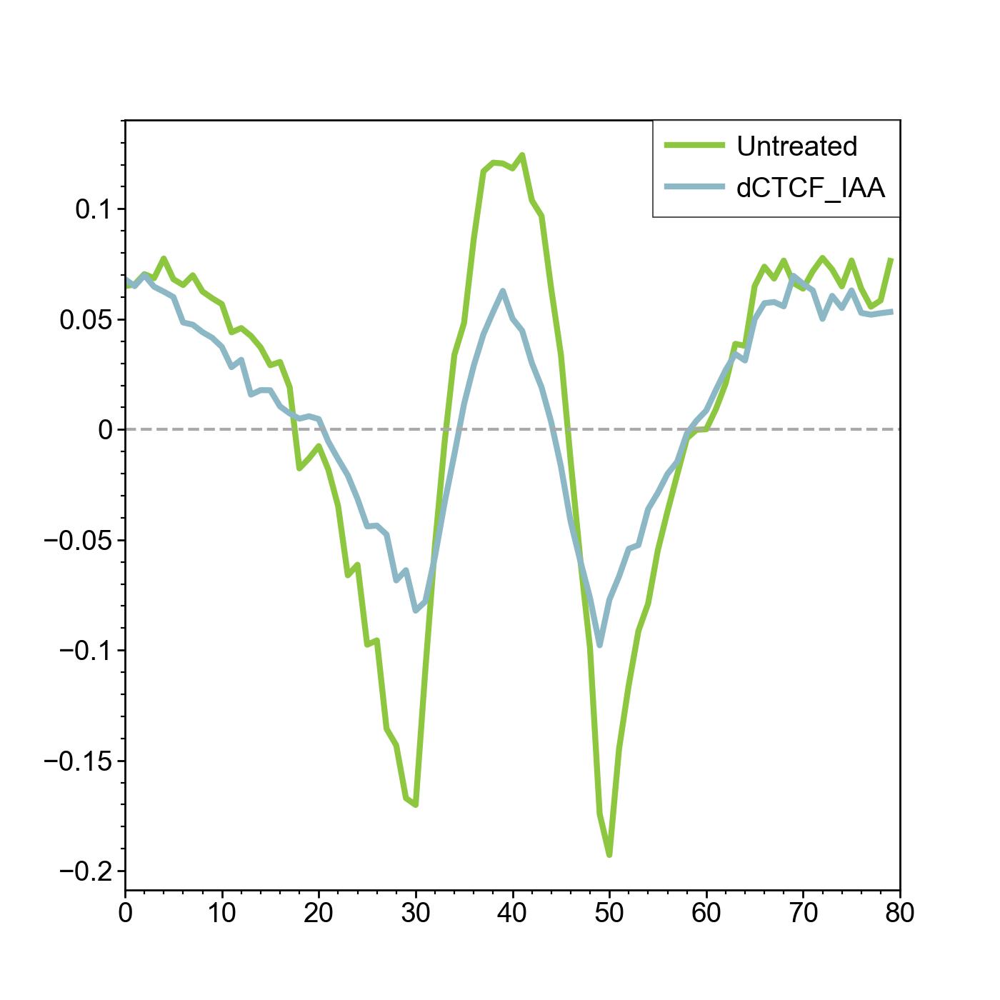

In [627]:
plt.figure(figsize=[7, 7])

pos = 20  # corresponds to 200 Kb disrance in Micro-C:

crosssec_3d = dict_mesc["pileup_w500Kb_r5Kb_dCTCF_UT"][3]
plt.plot(
    crosssec_3d[pos],
    label="Untreated",
    lw=3,
    color=colors_dct["cross-section high CTCF"],
)

crosssec_3d = dict_mesc["pileup_w500Kb_r5Kb_dCTCF_IAA"][3]
plt.plot(
    crosssec_3d[pos],
    label="dCTCF_IAA",
    lw=3,
    color=colors_dct["cross-section low CTCF"],
)

plt.legend()

plt.xlim(0, 80)

plt.plot([0, 80], [0, 0], "--", color="darkgrey")

if do_save:
    prefix = f"{output_folder}/SFig8a-right_crossections"
    plt.savefig(f"{prefix}.pdf")
    plt.savefig(f"{prefix}.png")
    print(f"Saved cross-section view to: {prefix}.pdf")

In [628]:
output.append(
    pd.DataFrame(
        {
            "Real data, Untreated, cross-sections": dict_mesc[
                "pileup_w500Kb_r5Kb_dCTCF_UT"
            ][3][pos],
            "Real data, dCTCF IAA, cross-sections": dict_mesc[
                "pileup_w500Kb_r5Kb_dCTCF_IAA"
            ][3][pos],
        }
    ).copy()
)

Saved protractor view to: /net/levsha/share/agalicina/simulations/chromatin_fountains//data/snippets//SFig8a-second-right_protractor.pdf


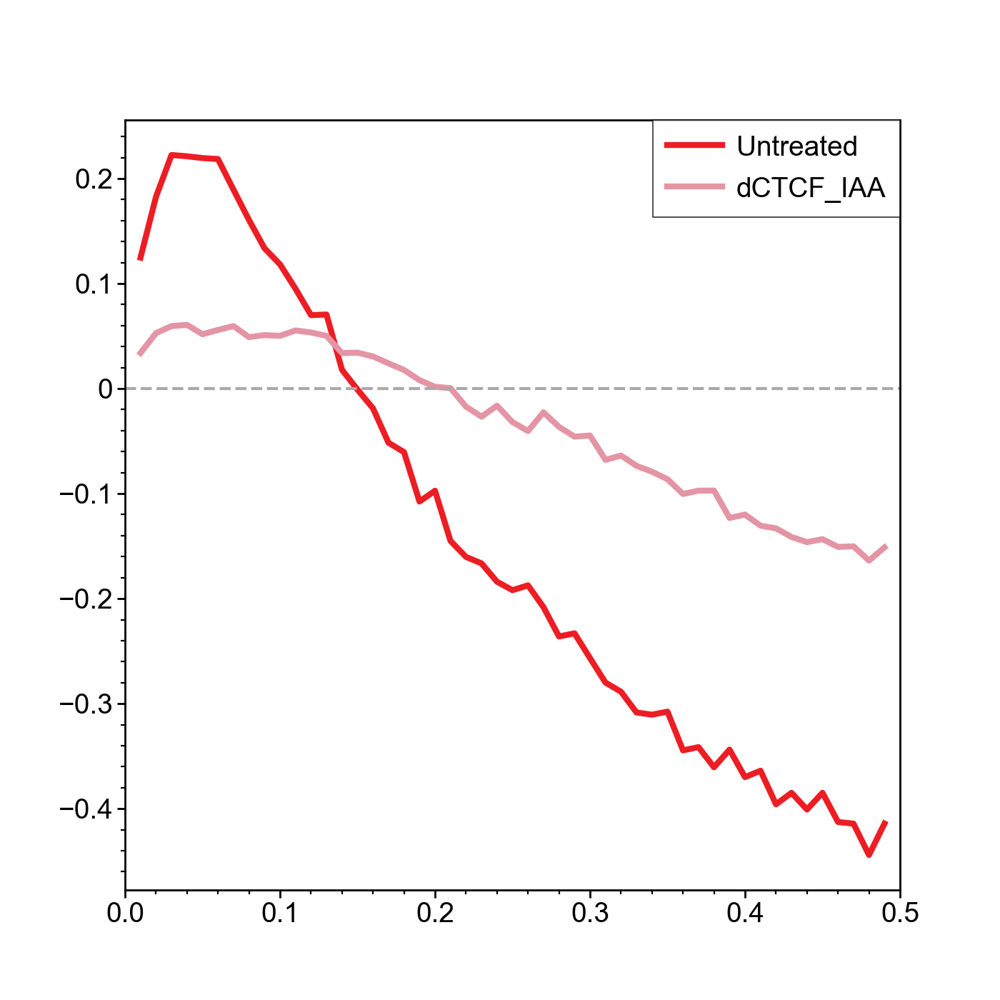

In [629]:
plt.figure(figsize=[7, 7])

protractor_3d = dict_mesc["pileup_w500Kb_r5Kb_dCTCF_UT"][2]
pos = len(protractor_3d) // 2

plt.plot(
    protractor_3d[pos],
    label="Untreated",
    lw=3,
    color=colors_dct["protractor high CTCF"],
)

protractor_3d = dict_mesc["pileup_w500Kb_r5Kb_dCTCF_IAA"][2]
plt.plot(
    protractor_3d[pos], label="dCTCF_IAA", lw=3, color=colors_dct["protractor low CTCF"]
)

plt.legend()

plt.xlim(0, 50)
plt.xticks(np.arange(0, 51, 10), 0.01 * np.arange(0, 51, 10))
plt.plot([0, 50], [0, 0], "--", color="darkgrey")

if do_save:
    prefix = f"{output_folder}/SFig8a-second-right_protractor"
    plt.savefig(f"{prefix}.pdf")
    plt.savefig(f"{prefix}.png")
    print(f"Saved protractor view to: {prefix}.pdf")

In [630]:
output.append(
    pd.DataFrame(
        {
            "Real data, Untreated, protractor": dict_mesc[
                "pileup_w500Kb_r5Kb_dCTCF_UT"
            ][2][pos],
            "Real data, dCTCF IAA, protractor": dict_mesc[
                "pileup_w500Kb_r5Kb_dCTCF_IAA"
            ][2][pos],
        }
    ).copy()
)

#### Load realistic simulations of 500 Kb region:

In [601]:
path = "/net/levsha/share/agalicina/simulations/chromatin_fountains/"
output_folder = f"{path}/data/snippets/"
mask = f"{path}/data/maps2d/realistic-*L_100.L-ctcf_100.ST_100.E_20*LP_1*.trajlen_10100.npy"
output_mask = "{path}/data/snippets/pileup_average_{f}"

In [602]:
files = sorted(glob.glob(f"{mask}"))

In [603]:
piles_types_selected = [
    ".L_100.L-ctcf_100.ST_100.E_20.tads_0.01_.LP_1",
    ".L_100.L-ctcf_100.ST_100.E_20.tads_0.25_.LP_1",
]

files = [
    x for x in files if piles_types_selected[0] in x or piles_types_selected[1] in x
]

In [604]:
len(files)

1888

In [605]:
piles = []
piles_collected = []

In [606]:
for file in tqdm.tqdm(files):
    output_file = output_mask.format(f=file.split("/")[-1], path=path)
    if file in piles_collected:
        continue
    elif os.path.isfile(output_file):
        pile_3d = np.load(output_file)
        piles.append([file, pile_3d.copy()])
        piles_collected.append(file)
    else:
        continue

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1888/1888 [02:06<00:00, 14.91it/s]


In [607]:
piles_types = [
    ".L_" + x[0].split(".L_")[1].split(".trajlen_10100.npy")[0] for x in piles
]

In [608]:
piles_types_unique = np.unique(piles_types)

In [609]:
len(piles)

719

Creating new figure...
Saved single simulation output to: /net/levsha/share/agalicina/simulations/chromatin_fountains//data/snippets//SFig8b-bottom-left.CTCF-0.25.10015-region.pdf


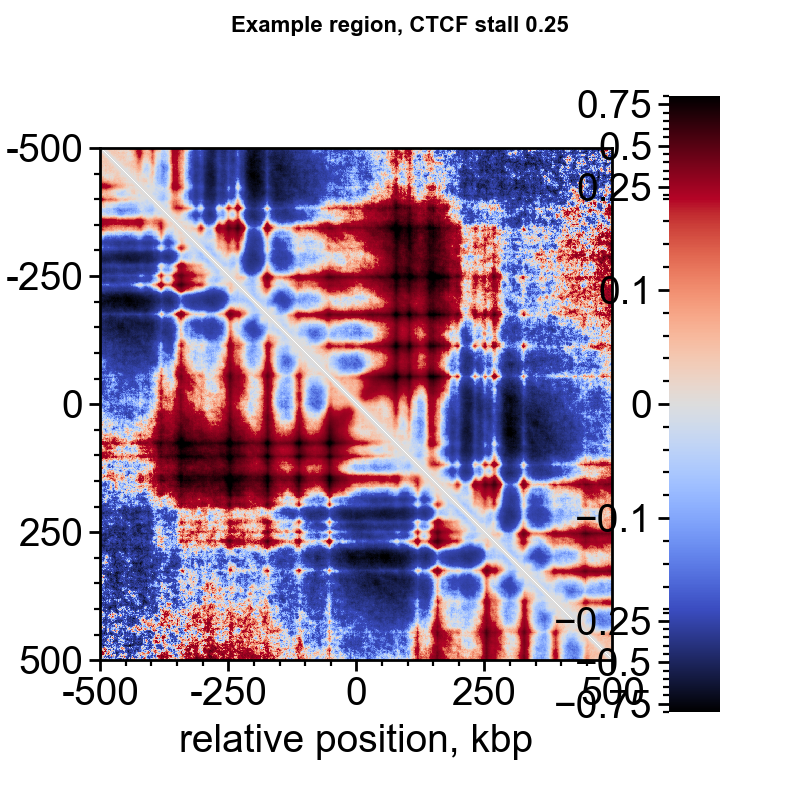

In [632]:
idx = "10015"

i = [
    x[0]
    for x in enumerate(piles)
    if "_" + idx + "." in x[1][0] and not "tads_0.01" in x[1][0]
][0]

fig = plot_heatmap_three_scales(
    piles[i][1],
    vmin_scale2=-factor2,
    vmin_scale1=-factor1,
    vmax_scale1=factor1,
    vmax_scale2=factor2,
    flank=500000,
    resolution=1000,
    interpolation="none",
    withlabels=True,
    cmap="coolwarm",
    cbar=True,
    log=False,
)

name = piles[i][0].split("/")[-1]
fig.suptitle("Example region, CTCF stall 0.25", size=8)

if do_save:
    prefix = f"{output_folder}/SFig8b-bottom-left.CTCF-0.25.10015-region"
    plt.savefig(f"{prefix}.pdf")
    plt.savefig(f"{prefix}.png")
    print(f"Saved single simulation output to: {prefix}.pdf")

Creating new figure...
Saved single simulation output to: /net/levsha/share/agalicina/simulations/chromatin_fountains//data/snippets//SFig8b-bottom-right.CTCF-0.01.10015-region.pdf


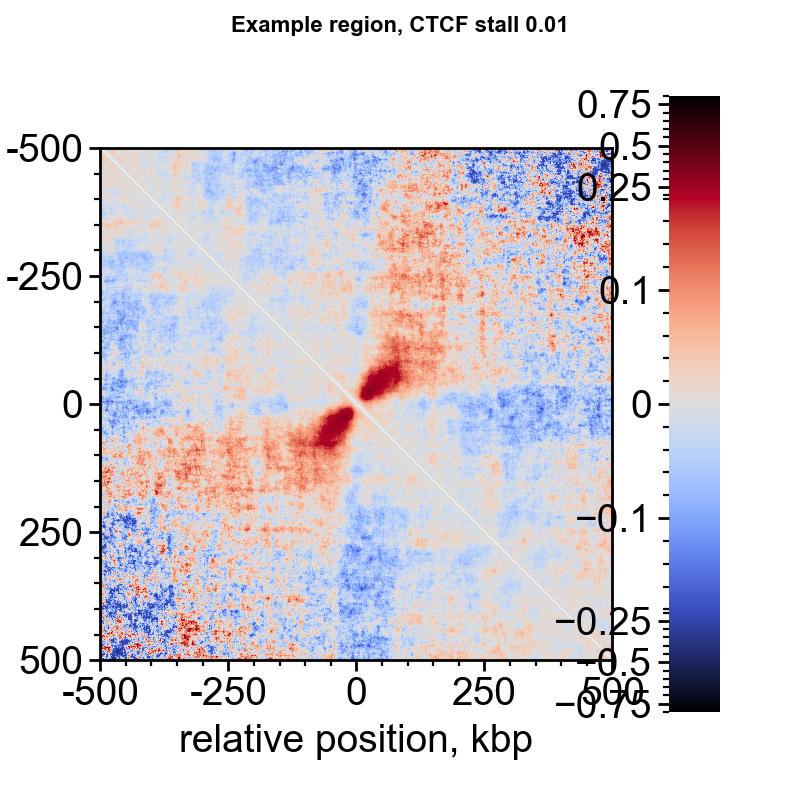

In [633]:
idx = "10015"

i = [
    x[0]
    for x in enumerate(piles)
    if "_" + idx + "." in x[1][0] and not "tads_0.25" in x[1][0]
][0]

fig = plot_heatmap_three_scales(
    piles[i][1],
    vmin_scale2=-factor2,
    vmin_scale1=-factor1,
    vmax_scale1=factor1,
    vmax_scale2=factor2,
    flank=500000,
    resolution=1000,
    interpolation="none",
    withlabels=True,
    cmap="coolwarm",
    cbar=True,
    log=False,
)

name = piles[i][0].split("/")[-1]
fig.suptitle("Example region, CTCF stall 0.01", size=8)

if do_save:
    prefix = f"{output_folder}/SFig8b-bottom-right.CTCF-0.01.10015-region"
    plt.savefig(f"{prefix}.pdf")
    plt.savefig(f"{prefix}.png")
    print(f"Saved single simulation output to: {prefix}.pdf")

In [644]:
piles_types_selected = [
    ("low CTCF", ".L_100.L-ctcf_100.ST_100.E_20.tads_0.01_.LP_1"),
    ("high CTCF", ".L_100.L-ctcf_100.ST_100.E_20.tads_0.25_.LP_1"),
]

df_selected = {}
for title, p_tp in piles_types_selected:
    selected = np.array(
        [x[0].split("ctcfs_")[1].split(".")[0] for x in piles if p_tp in x[0]]
    ).astype(int)
    df_selected[title] = selected.copy()

In [647]:
df_selected

{'low CTCF': array([10015, 10018, 10049, 10161,  1233,  1240,  1246,  1268,  1271,
         1282,  1283,  1286,  1296,  1330,  1362,  1363,  1366,  1377,
         1399,  1419,  1429,  1446,  1452,  1454,  1460,  1471,  1475,
         1484,  1492,  1513,  1517,  1527,  1528,  1531,  1534,  1563,
         1592,  1600,  1611,  1629,  1665,  1671,  1687,  1688,  1698,
         1699,  1704,  1722,  1726,  1730,  1741,  1743,  1747,  1748,
         1751,  1754,  1758,  1771,  1778,  1819,  1860,  2025,  2043,
         2126,  2155,  2271,   253,  2761,  2850,  2852,  2931,  2938,
         2942,  2952,  2991,  2993,  3012,  3022,  3032,  3048,  3055,
         3058,  3073,  3097,  3109,  3116,  3134,  3135,  3146,  3153,
         3160,  3162,  3163,  3168,  3169,  3177,  3184,  3200,  3222,
         3233,  3239,  3262,  3270,  3315,  3348,  3354,  3370,  3381,
         3386,  3414,  3416,  3423,  3426,  3442,  3444,  3451,  3455,
         3468,  3487,  3497,  3522,  3529,   353,  3531,  3547,  

350 .L_100.L-ctcf_100.ST_100.E_20.tads_0.01_.LP_1
Creating new figure...
Saved single simulation output to: /net/levsha/share/agalicina/simulations/chromatin_fountains//data/snippets//SFig8b-top-left.simulations.low CTCF.pdf
369 .L_100.L-ctcf_100.ST_100.E_20.tads_0.25_.LP_1
Creating new figure...
Saved single simulation output to: /net/levsha/share/agalicina/simulations/chromatin_fountains//data/snippets//SFig8b-top-left.simulations.high CTCF.pdf


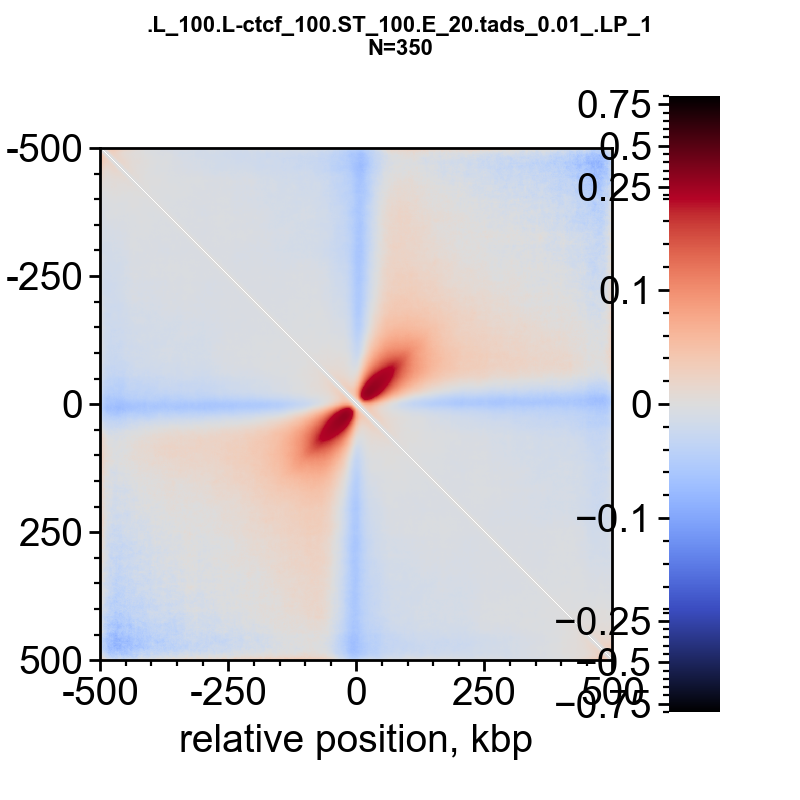

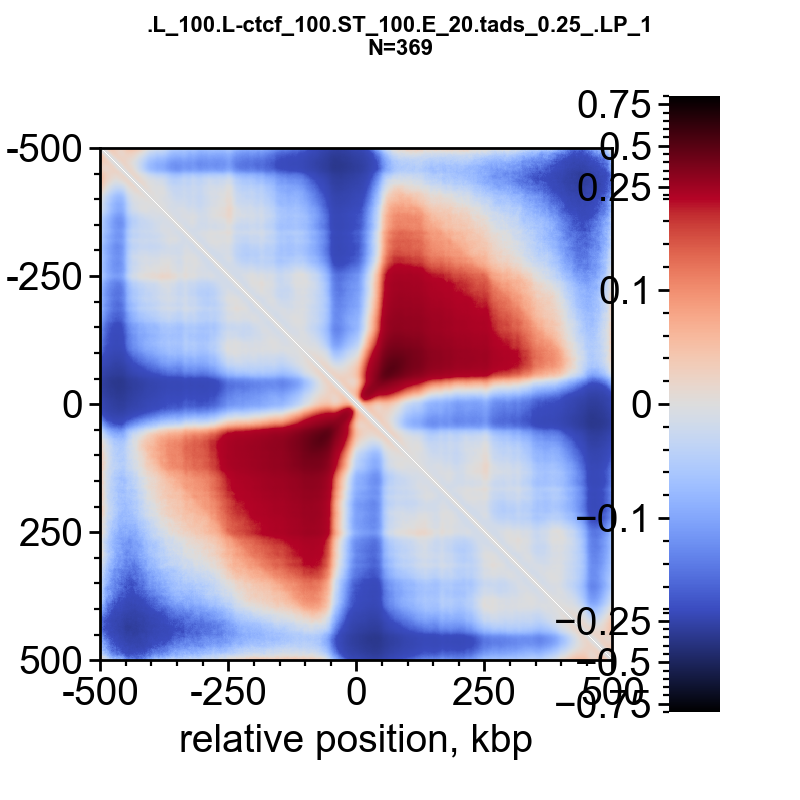

In [637]:
dict_pile_av_realistic = {}

piles_types_selected = [
    ("low CTCF", ".L_100.L-ctcf_100.ST_100.E_20.tads_0.01_.LP_1"),
    ("high CTCF", ".L_100.L-ctcf_100.ST_100.E_20.tads_0.25_.LP_1"),
]

# Plotting settings:
factor1 = 0.18
factor2 = 0.8

for title, p_tp in piles_types_selected:
    piles_selected = [x for x in piles if p_tp in x[0]]

    N = len(piles_selected)

    if N < 2:
        print(N, p_tp, "too low")
        continue

    print(N, p_tp)
    pile_av = np.nanmean([x[1] for x in piles_selected], axis=0).copy()

    window = 1000
    aggcoef = 10
    pile_3d_agg = numutils.zoom_array(pile_av, (window // aggcoef, window // aggcoef))

    protractor_3d = return_full_protractor(pile_3d_agg)
    crosssec_3d = return_cross_sections(pile_3d_agg)

    dict_pile_av_realistic[p_tp] = [
        pile_av.copy(),
        pile_3d_agg.copy(),
        protractor_3d.copy(),
        crosssec_3d.copy(),
    ]

    fig = plot_heatmap_three_scales(
        pile_av,
        vmin_scale2=-factor2,
        vmin_scale1=-factor1,
        vmax_scale1=factor1,
        vmax_scale2=factor2,
        flank=500000,
        resolution=1000,
        interpolation="none",
        withlabels=True,
        cmap="coolwarm",
        cbar=True,
        log=False,
    )
    fig.suptitle(f"{p_tp}\nN={N}", size=8)

    if do_save:
        prefix = f"{output_folder}/SFig8b-top-left.simulations.{title}"
        plt.savefig(f"{prefix}.pdf")
        plt.savefig(f"{prefix}.png")
        print(f"Saved single simulation output to: {prefix}.pdf")

##### Plot cross-sections and protractor for simulations (SFig. 8b right)

Saved cross-section view to: /net/levsha/share/agalicina/simulations/chromatin_fountains//data/snippets//SFig8b-right_crossections.pdf


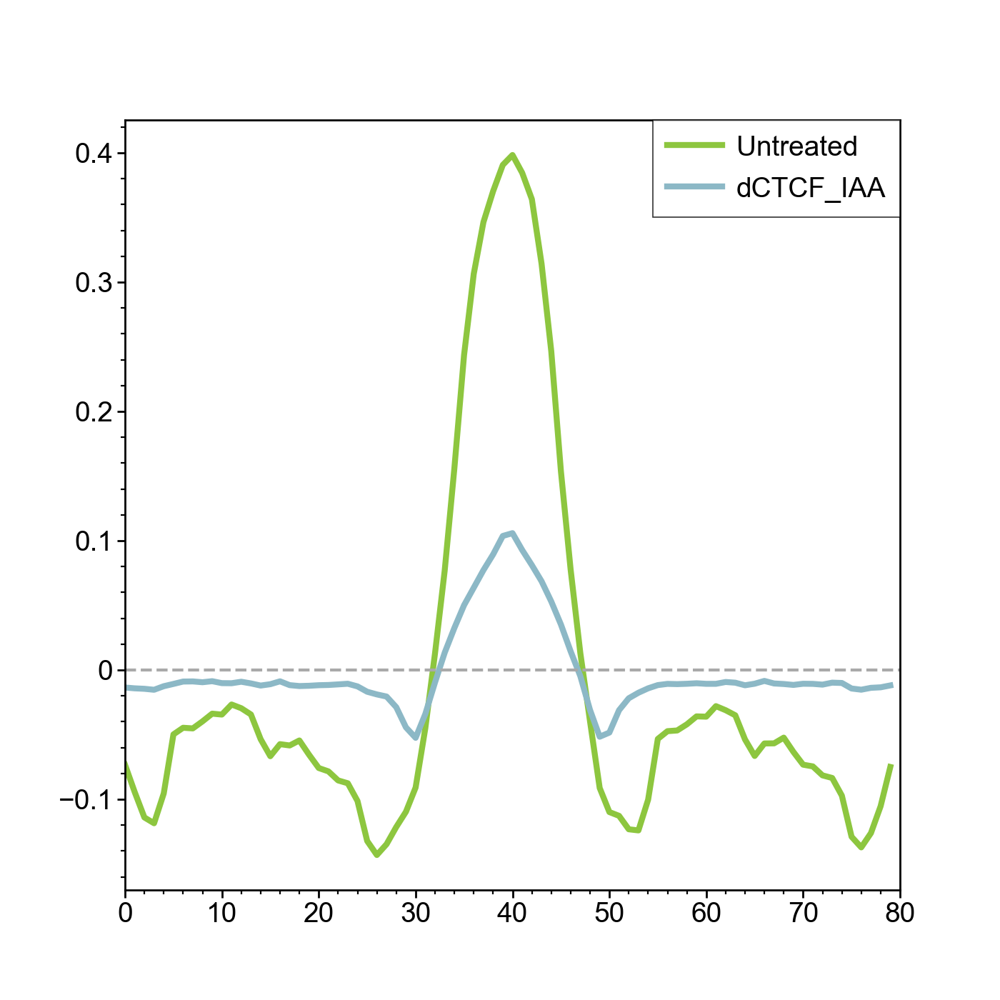

In [638]:
plt.figure(figsize=[7, 7])

pos = 20  # corresponds to 200 Kb disrance in Micro-C:

crosssec_3d = dict_pile_av_realistic[".L_100.L-ctcf_100.ST_100.E_20.tads_0.25_.LP_1"][3]
plt.plot(
    crosssec_3d[pos],
    label="Untreated",
    lw=3,
    color=colors_dct["cross-section high CTCF"],
)

crosssec_3d = dict_pile_av_realistic[".L_100.L-ctcf_100.ST_100.E_20.tads_0.01_.LP_1"][3]
plt.plot(
    crosssec_3d[pos],
    label="dCTCF_IAA",
    lw=3,
    color=colors_dct["cross-section low CTCF"],
)

plt.legend()

plt.xlim(0, 80)

plt.plot([0, 80], [0, 0], "--", color="darkgrey")

if do_save:
    prefix = f"{output_folder}/SFig8b-right_crossections"
    plt.savefig(f"{prefix}.pdf")
    plt.savefig(f"{prefix}.png")
    print(f"Saved cross-section view to: {prefix}.pdf")

Saved protractor view to: /net/levsha/share/agalicina/simulations/chromatin_fountains//data/snippets//SFig8b-second-right_protractor.pdf


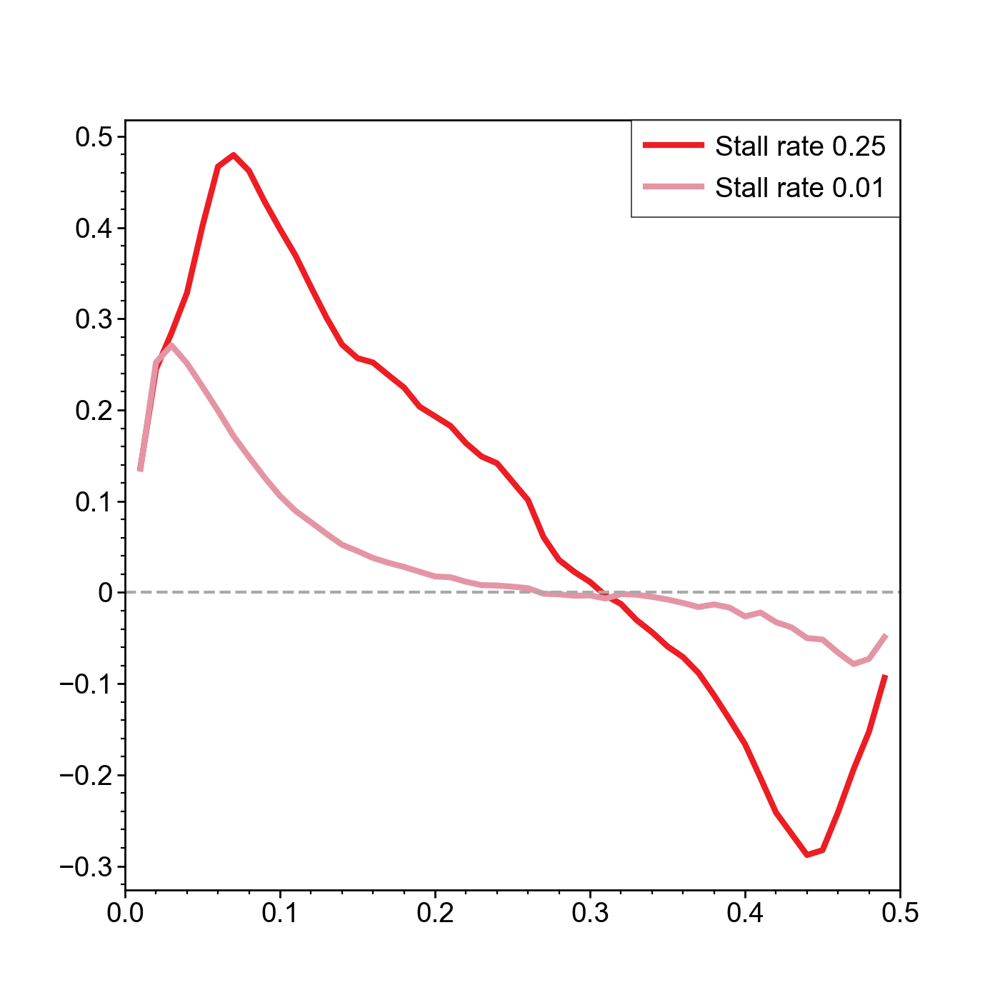

In [639]:
plt.figure(figsize=[7, 7])

protractor_3d = dict_pile_av_realistic[".L_100.L-ctcf_100.ST_100.E_20.tads_0.25_.LP_1"][
    2
]
pos = len(protractor_3d) // 2

plt.plot(
    protractor_3d[pos],
    label="Stall rate 0.25",
    lw=3,
    color=colors_dct["protractor high CTCF"],
)

protractor_3d = dict_pile_av_realistic[".L_100.L-ctcf_100.ST_100.E_20.tads_0.01_.LP_1"][
    2
]
plt.plot(
    protractor_3d[pos],
    label="Stall rate 0.01",
    lw=3,
    color=colors_dct["protractor low CTCF"],
)

plt.legend()

plt.xlim(0, 50)
plt.xticks(np.arange(0, 51, 10), 0.01 * np.arange(0, 51, 10))
plt.plot([0, 50], [0, 0], "--", color="darkgrey")

if do_save:
    prefix = f"{output_folder}/SFig8b-second-right_protractor"
    plt.savefig(f"{prefix}.pdf")
    plt.savefig(f"{prefix}.png")
    print(f"Saved protractor view to: {prefix}.pdf")

In [ ]:
section_flush()